In [13]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load in 

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
from collections import defaultdict
import seaborn as sns

mers = ['1_mer', '2_mer', '3_mer', '4_mer', '5_mer', '6_mer', '7_mer', '8_mer', '9_mer']
mer_dict = defaultdict(list) # gather each k-mer filename to this dictionary
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        for mer in mers:
            if mer in filename:
                mer_dict[mer].append(os.path.join(dirname, filename))
                break

# Any results you write to the current directory are saved as output.

In [14]:
# change the table_name to load a specific k-mer data (1 - 9 possible kmers).

table_name = '3_mer'

df_feature_2mer = pd.read_csv([i for i in mer_dict[table_name] if 'feature' in i][0])
df_feature_2mer.dropna(inplace=True)


# Analyze the metrics across different k-mers.
 - This will tell us which k-mer separates the classes well.
 - The documentation for the classification report can be found [here &#x2197;](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.classification_report.html)

### Example table: 

In [17]:
df_metrics_example = pd.read_csv([i for i in mer_dict['1_mer'] if 'metrics' in i][0], index_col=0)
df_metrics_example

,precision,recall,f1-score,support
feces,0.777778,0.583333,0.666667,12.000000
abdominal cavity,0.736842,0.777778,0.756757,18.000000
oronasopharynx,0.400000,0.181818,0.250000,11.000000
"lung, oronasopharynx",0.750000,0.916667,0.825000,36.000000
accuracy,0.727273,0.727273,0.727273,0.727273
macro avg,0.666155,0.614899,0.624606,77.000000
weighted avg,0.701253,0.727273,0.702229,77.000000


# Plot the wighted average of Precision, Recall and F1-score
 - Weighted Average :
Calculate metrics for each label, and find their average weighted by support (the number of true instances for each label). This alters ‘macro’ to *account for label imbalance*; it can result in an F-score that is not between precision and recall.

- We can conclude that the kmer with the hghest weighted average has the best classification power

In [32]:
# convert metrics to a single dataframe
# print("Metrics for orf1ab clasification based on the Isolation Source")
df_metrics_mer = pd.DataFrame(columns=['precision', 'recall', 'f1-score', 'support', 'kmer'])

for mer in mers:
    df_metrics = pd.read_csv([i for i in mer_dict[mer] if 'metrics' in i][0], index_col=0)
    df_metrics['kmer'] = mer
    df_metrics_mer= df_metrics_mer.append(df_metrics)
# df_metrics_mer.reset_index(level=0, inplace=True)[]
df_metrics_mer['source'] = df_metrics_mer.index
df_metrics_mer.reset_index(drop=True, inplace=True)
 
df_metrics_mer = df_metrics_mer[df_metrics_mer['source'].isin(['weighted avg'])] #['accuracy', 'weighted avg', 'macro avg']
df_metrics_mer = df_metrics_mer.drop('source', axis=1)
df_metrics_mer = df_metrics_mer.sort_values('f1-score', ascending= False).style.background_gradient(cmap='Greens',subset=["f1-score"])\
                        .background_gradient(cmap='Greens',subset=["recall"])\
                        .background_gradient(cmap='Blues',subset=["support"])\
                        .background_gradient(cmap='Greens',subset=["precision"])
df_metrics_mer

,precision,recall,f1-score,support,kmer
20,0.803875,0.805195,0.794777,77,3_mer
27,0.803875,0.805195,0.794777,77,4_mer
34,0.791317,0.792208,0.781165,77,5_mer
41,0.791317,0.792208,0.781165,77,6_mer
55,0.77255,0.779221,0.772237,77,8_mer
62,0.77255,0.779221,0.772237,77,9_mer
48,0.776663,0.779221,0.767307,77,7_mer
13,0.773534,0.779221,0.766958,77,2_mer
6,0.701253,0.727273,0.702229,77,1_mer


In [4]:
df_feature_2mer.sort_values('weight', ascending= False).style.background_gradient(cmap='Greens',subset=["weight"])

In [5]:
def filter_column(df, column_name, min_count):
    '''
    df: dataframe
    column_name: column to filter
    min_count: minimum count required to be included
    '''
    counts = Counter(df[column_name])
    filtered = [key for key in counts if counts[key] >= min_count]
    print(filtered)
    df = df[df[column_name].isin(filtered)]
    return df[df[column_name].notna()]
    

In [6]:
df_feature_2mer.head()
df_feature_2mer.round(4)

,target,feature,weight
0,abdominal cavity,YGL,0.3292
1,abdominal cavity,DYG,0.3255
2,abdominal cavity,SFA,0.3018
3,abdominal cavity,VLV,0.2793
4,abdominal cavity,ASF,0.2789
...,...,...,...
31419,oronasopharynx,KIG,-0.2832
31420,oronasopharynx,DVA,-0.2915
31421,oronasopharynx,ETS,-0.2963
31422,oronasopharynx,GFM,-0.3243


In [7]:
# target feature weight
targets = df_feature_2mer['target'].unique()
features = df_feature_2mer['feature'].unique()
weights = []
for f in features:
    wt = []
    df1 = df_feature_2mer[df_feature_2mer["feature"].isin([f])]
    for t in targets:
        
        df = df1[df1["target"].isin([t])]
        wt.append(df['weight'].values[0])
        print(df.head())
    wt = [round(num, 4) for num in wt]
    weights.append(np.asarray(wt))

             target feature    weight
0  abdominal cavity     YGL  0.329206
      target feature    weight
15710  feces     YGL -0.279416
                     target feature    weight
21035  lung, oronasopharynx     YGL -0.000893
               target feature    weight
30994  oronasopharynx     YGL -0.048897
             target feature    weight
1  abdominal cavity     DYG  0.325544
      target feature  weight
15708  feces     DYG -0.2732
                     target feature    weight
15742  lung, oronasopharynx     DYG  0.204172
               target feature    weight
31413  oronasopharynx     DYG -0.256516
             target feature    weight
2  abdominal cavity     SFA  0.301778
      target feature    weight
15711  feces     SFA -0.301082
                     target feature   weight
20933  lung, oronasopharynx     SFA -0.00084
               target feature    weight
27135  oronasopharynx     SFA  0.000144
             target feature    weight
3  abdominal cavity     VLV  0.279329


              target feature   weight
33  abdominal cavity     ADA  0.16063
      target feature    weight
15665  feces     ADA -0.144961
                     target feature    weight
21289  lung, oronasopharynx     ADA -0.001052
               target feature    weight
30494  oronasopharynx     ADA -0.014616
              target feature    weight
34  abdominal cavity     SIK  0.159763
      target feature   weight
15670  feces     SIK -0.15269
                     target feature    weight
22344  lung, oronasopharynx     SIK -0.002289
               target feature    weight
29627  oronasopharynx     SIK -0.004784
              target feature    weight
35  abdominal cavity     SVF  0.157566
      target feature    weight
15680  feces     SVF -0.160696
                     target feature    weight
23398  lung, oronasopharynx     SVF -0.096542
               target feature    weight
23737  oronasopharynx     SVF  0.099672
              target feature    weight
36  abdominal cavity     DSI 

      target feature    weight
15629  feces     EAI -0.115273
                     target feature    weight
23004  lung, oronasopharynx     EAI -0.022198
               target feature    weight
24591  oronasopharynx     EAI  0.012554
              target feature    weight
78  abdominal cavity     VTL  0.124321
      target feature    weight
15620  feces     VTL -0.110043
                     target feature    weight
16420  lung, oronasopharynx     VTL  0.014006
               target feature    weight
30777  oronasopharynx     VTL -0.028284
              target feature    weight
79  abdominal cavity     EGK  0.123228
      target feature    weight
15648  feces     EGK -0.123935
                     target feature    weight
17108  lung, oronasopharynx     EGK  0.000995
               target feature    weight
27655  oronasopharynx     EGK -0.000288
              target feature   weight
80  abdominal cavity     AGI  0.12234
      target feature   weight
14365  feces     AGI -0.01492
      

                     target feature    weight
15734  lung, oronasopharynx     DVA  0.213842
               target feature    weight
31420  oronasopharynx     DVA -0.291507
               target feature    weight
117  abdominal cavity     YDF  0.103168
      target feature    weight
15594  feces     YDF -0.096894
                     target feature    weight
22333  lung, oronasopharynx     YDF -0.002267
               target feature    weight
29456  oronasopharynx     YDF -0.004007
               target feature    weight
118  abdominal cavity     ARS  0.102236
      target feature    weight
15564  feces     ARS -0.090158
                     target feature  weight
17103  lung, oronasopharynx     ARS   0.001
               target feature    weight
30430  oronasopharynx     ARS -0.013079
               target feature    weight
119  abdominal cavity     LVA  0.102219
      target feature    weight
15600  feces     LVA -0.099758
                     target feature    weight
23438  lung, oro

21637  lung, oronasopharynx     YVT -0.001319
               target feature    weight
30099  oronasopharynx     YVT -0.008441
               target feature    weight
145  abdominal cavity     VAP  0.092956
      target feature   weight
15614  feces     VAP -0.10687
                     target feature    weight
15724  lung, oronasopharynx     VAP  0.239693
               target feature    weight
31407  oronasopharynx     VAP -0.225779
               target feature    weight
146  abdominal cavity     DGT  0.092949
      target feature    weight
15566  feces     DGT -0.090297
                     target feature    weight
21385  lung, oronasopharynx     DGT -0.001108
               target feature    weight
28537  oronasopharynx     DGT -0.001543
               target feature    weight
147  abdominal cavity     YMD  0.091844
      target feature    weight
15574  feces     YMD -0.092024
                     target feature    weight
20855  lung, oronasopharynx     YMD -0.000803
              

      target feature    weight
15584  feces     SCG -0.094175
                     target feature    weight
16614  lung, oronasopharynx     SCG  0.003368
               target feature   weight
24923  oronasopharynx     SCG  0.00782
               target feature    weight
190  abdominal cavity     FAN  0.082951
      target feature    weight
15477  feces     FAN -0.070362
                     target feature    weight
22802  lung, oronasopharynx     FAN -0.012379
               target feature    weight
27590  oronasopharynx     FAN -0.000211
               target feature    weight
191  abdominal cavity     NSH  0.082546
      target feature    weight
15511  feces     NSH -0.078186
                     target feature    weight
19323  lung, oronasopharynx     NSH -0.000261
               target feature    weight
29475  oronasopharynx     NSH -0.004099
               target feature   weight
192  abdominal cavity     ITP  0.08239
      target feature    weight
15557  feces     ITP -0.088873


                     target feature    weight
16378  lung, oronasopharynx     IQI  0.015783
               target feature    weight
30366  oronasopharynx     IQI -0.011984
               target feature    weight
228  abdominal cavity     DNV  0.071116
      target feature    weight
15360  feces     DNV -0.058077
                     target feature    weight
16317  lung, oronasopharynx     DNV  0.020943
               target feature    weight
30851  oronasopharynx     DNV -0.033981
               target feature    weight
229  abdominal cavity     VVD  0.071001
      target feature    weight
15494  feces     VVD -0.074487
                     target feature    weight
23432  lung, oronasopharynx     VVD -0.110915
               target feature    weight
23702  oronasopharynx     VVD  0.114401
               target feature    weight
230  abdominal cavity     GFC  0.070794
      target feature    weight
15490  feces     GFC -0.072779
                     target feature    weight
22091  lung,

               target feature   weight
257  abdominal cavity     DDV  0.06626
      target feature    weight
15375  feces     DDV -0.059757
                     target feature    weight
22443  lung, oronasopharynx     DDV -0.002644
               target feature    weight
29411  oronasopharynx     DDV -0.003858
               target feature    weight
258  abdominal cavity     VMT  0.066196
      target feature    weight
15478  feces     VMT -0.070542
                     target feature    weight
17588  lung, oronasopharynx     VMT  0.000462
               target feature    weight
25449  oronasopharynx     VMT  0.003884
               target feature    weight
259  abdominal cavity     NCI  0.066126
      target feature   weight
15245  feces     NCI -0.04685
                     target feature    weight
22151  lung, oronasopharynx     NCI -0.001924
               target feature    weight
30573  oronasopharynx     NCI -0.017352
               target feature   weight
260  abdominal cavity  

               target feature    weight
296  abdominal cavity     LXT  0.061932
      target feature    weight
15388  feces     LXT -0.061111
                     target feature        weight
18032  lung, oronasopharynx     LXT -2.832943e-07
               target feature   weight
28071  oronasopharynx     LXT -0.00082
               target feature    weight
297  abdominal cavity     HCV  0.061865
      target feature    weight
15361  feces     HCV -0.058182
                     target feature    weight
21709  lung, oronasopharynx     HCV -0.001375
               target feature    weight
28929  oronasopharynx     HCV -0.002308
               target feature   weight
298  abdominal cavity     TCD  0.06151
      target feature    weight
15487  feces     TCD -0.072525
                     target feature    weight
21842  lung, oronasopharynx     TCD -0.001516
               target feature    weight
24592  oronasopharynx     TCD  0.012531
               target feature    weight
299  abdominal

               target feature    weight
339  abdominal cavity     YYF  0.057293
      target feature    weight
15330  feces     YYF -0.054511
                     target feature    weight
20147  lung, oronasopharynx     YYF -0.000501
               target feature    weight
28913  oronasopharynx     YYF -0.002281
               target feature    weight
340  abdominal cavity     ASC  0.057285
      target feature   weight
15353  feces     ASC -0.05755
                     target feature    weight
22186  lung, oronasopharynx     ASC -0.001978
               target feature    weight
25940  oronasopharynx     ASC  0.002243
               target feature    weight
341  abdominal cavity     GIY  0.057146
      target feature    weight
15341  feces     GIY -0.056137
                     target feature    weight
19092  lung, oronasopharynx     GIY -0.000149
               target feature   weight
28104  oronasopharynx     GIY -0.00086
               target feature    weight
342  abdominal cavity 

                     target feature   weight
23277  lung, oronasopharynx     ERL -0.06329
               target feature    weight
23946  oronasopharynx     ERL  0.054311
               target feature    weight
390  abdominal cavity     TAD  0.052951
      target feature    weight
15372  feces     TAD -0.059629
                     target feature    weight
16089  lung, oronasopharynx     TAD  0.052706
               target feature    weight
30972  oronasopharynx     TAD -0.046029
               target feature    weight
391  abdominal cavity     KDA  0.052828
      target feature    weight
15187  feces     KDA -0.042888
                     target feature    weight
22249  lung, oronasopharynx     KDA -0.002085
               target feature    weight
30041  oronasopharynx     KDA -0.007855
               target feature    weight
392  abdominal cavity     SFG  0.052607
      target feature    weight
15139  feces     SFG -0.039996
                     target feature    weight
22168  lung, o

                     target feature    weight
19034  lung, oronasopharynx     SPI -0.000136
               target feature    weight
28884  oronasopharynx     SPI -0.002208
               target feature    weight
426  abdominal cavity     GVM  0.049226
      target feature    weight
15338  feces     GVM -0.056037
                     target feature    weight
19286  lung, oronasopharynx     GVM -0.000241
               target feature    weight
24989  oronasopharynx     GVM  0.007052
               target feature    weight
427  abdominal cavity     GHG  0.049207
      target feature    weight
15282  feces     GHG -0.049943
                     target feature    weight
20221  lung, oronasopharynx     GHG -0.000528
               target feature    weight
26365  oronasopharynx     GHG  0.001265
               target feature    weight
428  abdominal cavity     GLA  0.049197
      target feature    weight
15289  feces     GLA -0.050435
                     target feature    weight
17021  lung,

               target feature    weight
477  abdominal cavity     FDV  0.044811
      target feature    weight
15136  feces     FDV -0.039904
                     target feature    weight
23025  lung, oronasopharynx     FDV -0.024689
               target feature    weight
24352  oronasopharynx     FDV  0.019781
               target feature    weight
478  abdominal cavity     WIV  0.044385
      target feature    weight
15219  feces     WIV -0.044848
                     target feature   weight
18857  lung, oronasopharynx     WIV -0.00009
               target feature    weight
26832  oronasopharynx     WIV  0.000553
               target feature    weight
479  abdominal cavity     SIQ  0.044313
      target feature    weight
15067  feces     SIQ -0.036026
                     target feature   weight
20820  lung, oronasopharynx     SIQ -0.00079
               target feature    weight
30010  oronasopharynx     SIQ -0.007496
               target feature    weight
480  abdominal cavity 

14433  feces     AAL -0.01634
                     target feature    weight
23448  lung, oronasopharynx     AAL -0.123044
               target feature    weight
23740  oronasopharynx     AAL  0.097721
               target feature    weight
517  abdominal cavity     VCS  0.041575
     target feature   weight
9423  feces     VCS  0.01357
                     target feature    weight
23127  lung, oronasopharynx     VCS -0.037417
               target feature    weight
30580  oronasopharynx     VCS -0.017728
               target feature    weight
518  abdominal cavity     AKV  0.041516
      target feature    weight
10103  feces     AKV  0.006405
                     target feature    weight
18867  lung, oronasopharynx     AKV -0.000093
               target feature    weight
30986  oronasopharynx     AKV -0.047827
               target feature    weight
519  abdominal cavity     ERA  0.041503
      target feature    weight
15157  feces     ERA -0.040667
                     target feat

                     target feature    weight
21221  lung, oronasopharynx     KCS -0.001013
               target feature    weight
25798  oronasopharynx     KCS  0.002634
               target feature   weight
558  abdominal cavity     KYI  0.03923
      target feature   weight
15059  feces     KYI -0.03563
                     target feature   weight
22872  lung, oronasopharynx     KYI -0.01523
               target feature   weight
24625  oronasopharynx     KYI  0.01163
               target feature    weight
559  abdominal cavity     EIP  0.039061
      target feature    weight
15343  feces     EIP -0.056631
                     target feature    weight
23562  lung, oronasopharynx     EIP -0.331427
               target feature    weight
23571  oronasopharynx     EIP  0.348996
               target feature    weight
560  abdominal cavity     YSE  0.039024
      target feature    weight
15161  feces     YSE -0.040842
                     target feature    weight
18884  lung, oronaso

19289  lung, oronasopharynx     MSV -0.000244
               target feature    weight
28763  oronasopharynx     MSV -0.001982
               target feature    weight
598  abdominal cavity     LEK  0.036834
      target feature    weight
15068  feces     LEK -0.036046
                     target feature    weight
18906  lung, oronasopharynx     LEK -0.000106
               target feature    weight
27990  oronasopharynx     LEK -0.000682
               target feature    weight
599  abdominal cavity     MNY  0.036781
      target feature    weight
14906  feces     MNY -0.029208
                     target feature    weight
20550  lung, oronasopharynx     MNY -0.000654
               target feature    weight
29933  oronasopharynx     MNY -0.006919
               target feature    weight
600  abdominal cavity     DCS  0.036762
      target feature    weight
15085  feces     DCS -0.036927
                     target feature    weight
21886  lung, oronasopharynx     DCS -0.001563
            

                     target feature   weight
20095  lung, oronasopharynx     RDT -0.00048
               target feature    weight
28005  oronasopharynx     RDT -0.000704
               target feature    weight
648  abdominal cavity     SLD  0.034148
      target feature    weight
14932  feces     SLD -0.030174
                     target feature    weight
23550  lung, oronasopharynx     SLD -0.243321
               target feature    weight
23587  oronasopharynx     SLD  0.239348
               target feature    weight
649  abdominal cavity     YQS  0.034133
      target feature    weight
11942  feces     YQS  0.000168
                     target feature    weight
18547  lung, oronasopharynx     YQS -0.000026
               target feature    weight
30856  oronasopharynx     YQS -0.034276
               target feature    weight
650  abdominal cavity     GIP  0.034122
      target feature    weight
11331  feces     GIP  0.001325
                     target feature    weight
15756  lung, o

                     target feature    weight
20909  lung, oronasopharynx     AMG -0.000826
               target feature    weight
26118  oronasopharynx     AMG  0.001795
               target feature   weight
678  abdominal cavity     YFY  0.03347
      target feature    weight
15004  feces     YFY -0.033669
                     target feature    weight
20825  lung, oronasopharynx     YFY -0.000791
               target feature   weight
26507  oronasopharynx     YFY  0.00099
               target feature    weight
679  abdominal cavity     ECC  0.033443
      target feature   weight
15021  feces     ECC -0.03417
                     target feature    weight
19784  lung, oronasopharynx     ECC -0.000392
               target feature    weight
26431  oronasopharynx     ECC  0.001119
               target feature    weight
680  abdominal cavity     ILV  0.033371
      target feature   weight
14612  feces     ILV -0.02013
                     target feature    weight
22921  lung, oronaso

24225  oronasopharynx     CGS  0.026237
               target feature    weight
712  abdominal cavity     SVG  0.032131
      target feature    weight
12889  feces     SVG -0.001728
                     target feature    weight
23205  lung, oronasopharynx     SVG -0.051016
               target feature    weight
24330  oronasopharynx     SVG  0.020613
               target feature   weight
713  abdominal cavity     LFN  0.03212
      target feature   weight
14542  feces     LFN -0.01862
                     target feature    weight
20168  lung, oronasopharynx     LFN -0.000507
               target feature    weight
30421  oronasopharynx     LFN -0.012993
               target feature    weight
714  abdominal cavity     LPT  0.032063
      target feature    weight
14915  feces     LPT -0.029515
                     target feature    weight
23324  lung, oronasopharynx     LPT -0.072421
               target feature    weight
23843  oronasopharynx     LPT  0.069873
               target 

15002  feces     YDH -0.033553
                     target feature    weight
20737  lung, oronasopharynx     YDH -0.000747
               target feature    weight
25533  oronasopharynx     YDH  0.003555
               target feature    weight
759  abdominal cavity     PIG  0.030737
      target feature   weight
15033  feces     PIG -0.03461
                     target feature    weight
23379  lung, oronasopharynx     PIG -0.087198
               target feature    weight
23760  oronasopharynx     PIG  0.091071
               target feature    weight
760  abdominal cavity     IAA  0.030713
      target feature    weight
14284  feces     IAA -0.013357
                     target feature    weight
22485  lung, oronasopharynx     IAA -0.002894
               target feature    weight
30489  oronasopharynx     IAA -0.014461
               target feature    weight
761  abdominal cavity     YGI  0.030687
      target feature    weight
15151  feces     YGI -0.040302
                     target f

               target feature    weight
803  abdominal cavity     IQV  0.028745
      target feature    weight
15174  feces     IQV -0.042192
                     target feature    weight
16114  lung, oronasopharynx     IQV  0.045658
               target feature    weight
30826  oronasopharynx     IQV -0.032211
               target feature    weight
804  abdominal cavity     YPR  0.028632
      target feature    weight
14891  feces     YPR -0.028589
                     target feature    weight
17415  lung, oronasopharynx     YPR  0.000653
               target feature    weight
27998  oronasopharynx     YPR -0.000696
               target feature   weight
805  abdominal cavity     STY  0.02862
      target feature    weight
14555  feces     STY -0.018994
                     target feature    weight
23023  lung, oronasopharynx     STY -0.024601
               target feature    weight
24496  oronasopharynx     STY  0.014976
               target feature    weight
806  abdominal cavit

      target feature    weight
14740  feces     KIR -0.023905
                     target feature    weight
17079  lung, oronasopharynx     KIR  0.001029
               target feature    weight
29348  oronasopharynx     KIR -0.003631
               target feature   weight
857  abdominal cavity     ISG  0.02644
      target feature    weight
14711  feces     ISG -0.023007
                     target feature    weight
23403  lung, oronasopharynx     ISG -0.098141
               target feature    weight
23748  oronasopharynx     ISG  0.094708
               target feature    weight
858  abdominal cavity     AAN  0.026437
      target feature    weight
14677  feces     AAN -0.022011
                     target feature    weight
22623  lung, oronasopharynx     AAN -0.003888
               target feature    weight
27868  oronasopharynx     AAN -0.000538
               target feature    weight
859  abdominal cavity     KES  0.026423
      target feature    weight
14526  feces     KES -0.01817

               target feature    weight
931  abdominal cavity     YSK  0.024563
      target feature    weight
14684  feces     YSK -0.022284
                     target feature    weight
19794  lung, oronasopharynx     YSK -0.000396
               target feature    weight
28711  oronasopharynx     YSK -0.001883
               target feature    weight
932  abdominal cavity     EVR  0.024547
      target feature    weight
14865  feces     EVR -0.027801
                     target feature    weight
16809  lung, oronasopharynx     EVR  0.001759
               target feature    weight
26260  oronasopharynx     EVR  0.001495
               target feature    weight
933  abdominal cavity     ACY  0.024536
      target feature    weight
14253  feces     ACY -0.012788
                     target feature    weight
20756  lung, oronasopharynx     ACY -0.000757
               target feature    weight
30300  oronasopharynx     ACY -0.010991
               target feature    weight
934  abdominal cav

               target feature    weight
969  abdominal cavity     KTP  0.023169
      target feature    weight
14633  feces     KTP -0.020792
                     target feature    weight
17723  lung, oronasopharynx     KTP  0.000325
               target feature    weight
29081  oronasopharynx     KTP -0.002702
               target feature    weight
970  abdominal cavity     TPL  0.023142
      target feature    weight
14985  feces     TPL -0.032911
                     target feature    weight
19172  lung, oronasopharynx     TPL -0.000186
               target feature    weight
24740  oronasopharynx     TPL  0.009955
               target feature   weight
971  abdominal cavity     VHC  0.02313
      target feature   weight
14671  feces     VHC -0.02181
                     target feature    weight
20237  lung, oronasopharynx     VHC -0.000534
               target feature    weight
28059  oronasopharynx     VHC -0.000786
               target feature    weight
972  abdominal cavity 

               target feature    weight
30033  oronasopharynx     LWQ -0.007754
                target feature    weight
1028  abdominal cavity     ATM  0.021506
      target feature    weight
14423  feces     ATM -0.016116
                     target feature    weight
20794  lung, oronasopharynx     ATM -0.000777
               target feature    weight
29594  oronasopharynx     ATM -0.004613
                target feature    weight
1029  abdominal cavity     AEH  0.021475
      target feature    weight
14699  feces     AEH -0.022648
                     target feature   weight
20122  lung, oronasopharynx     AEH -0.00049
               target feature    weight
26176  oronasopharynx     AEH  0.001663
                target feature    weight
1030  abdominal cavity     RRW  0.021412
      target feature   weight
14549  feces     RRW -0.01876
                     target feature    weight
20198  lung, oronasopharynx     RRW -0.000521
               target feature   weight
28836  oronasopha

               target feature    weight
28796  oronasopharynx     NQN -0.002047
                target feature    weight
1067  abdominal cavity     IIE  0.020082
      target feature    weight
14494  feces     IIE -0.017508
                     target feature    weight
20566  lung, oronasopharynx     IIE -0.000661
               target feature    weight
28732  oronasopharynx     IIE -0.001912
                target feature    weight
1068  abdominal cavity     GLD  0.020056
      target feature    weight
15007  feces     GLD -0.033745
                     target feature    weight
23295  lung, oronasopharynx     GLD -0.066777
               target feature    weight
23790  oronasopharynx     GLD  0.080466
                target feature    weight
1069  abdominal cavity     ATT  0.020052
      target feature    weight
14354  feces     ATT -0.014725
                     target feature    weight
22062  lung, oronasopharynx     ATT -0.001772
               target feature    weight
29325  orona

                target feature    weight
1103  abdominal cavity     QKH  0.019049
      target feature    weight
14503  feces     QKH -0.017744
                     target feature    weight
16407  lung, oronasopharynx     QKH  0.014704
               target feature    weight
30539  oronasopharynx     QKH -0.016009
                target feature    weight
1104  abdominal cavity     LVT  0.019007
     target feature    weight
9291  feces     LVT  0.015537
                     target feature    weight
17353  lung, oronasopharynx     LVT  0.000737
               target feature    weight
30864  oronasopharynx     LVT -0.035281
                target feature  weight
1105  abdominal cavity     SYA   0.019
      target feature    weight
13839  feces     SYA -0.007872
                     target feature    weight
21168  lung, oronasopharynx     SYA -0.000973
               target feature    weight
30242  oronasopharynx     SYA -0.010154
                target feature    weight
1106  abdominal c

                     target feature    weight
20769  lung, oronasopharynx     IYC -0.000761
               target feature    weight
29712  oronasopharynx     IYC -0.005252
                target feature    weight
1151  abdominal cavity     CLK  0.017793
      target feature    weight
14445  feces     CLK -0.016497
                     target feature    weight
23065  lung, oronasopharynx     CLK -0.027773
               target feature    weight
24218  oronasopharynx     CLK  0.026478
                target feature    weight
1152  abdominal cavity     ESF  0.017755
      target feature    weight
14595  feces     ESF -0.019735
                     target feature    weight
22238  lung, oronasopharynx     ESF -0.002068
               target feature    weight
25417  oronasopharynx     ESF  0.004047
                target feature    weight
1153  abdominal cavity     NHL  0.017724
      target feature    weight
14620  feces     NHL -0.020379
                     target feature    weight
20883 

                target feature    weight
1189  abdominal cavity     TYG  0.016664
      target feature    weight
14357  feces     TYG -0.014729
                     target feature    weight
20976  lung, oronasopharynx     TYG -0.000862
               target feature    weight
28232  oronasopharynx     TYG -0.001073
                target feature    weight
1190  abdominal cavity     TMI  0.016648
      target feature   weight
14648  feces     TMI -0.02121
                     target feature    weight
15957  lung, oronasopharynx     TMI  0.075511
               target feature    weight
31132  oronasopharynx     TMI -0.070949
                target feature    weight
1191  abdominal cavity     SLC  0.016596
     target feature    weight
9246  feces     SLC  0.016192
                     target feature    weight
19848  lung, oronasopharynx     SLC -0.000413
               target feature    weight
30828  oronasopharynx     SLC -0.032376
                target feature    weight
1192  abdominal

28410  oronasopharynx     GRI -0.001371
                target feature    weight
1231  abdominal cavity     CPI  0.015588
      target feature    weight
14317  feces     CPI -0.013976
                     target feature    weight
21224  lung, oronasopharynx     CPI -0.001015
               target feature    weight
27932  oronasopharynx     CPI -0.000597
                target feature    weight
1232  abdominal cavity     QPS  0.015587
      target feature    weight
14009  feces     QPS -0.009494
                     target feature    weight
20910  lung, oronasopharynx     QPS -0.000826
               target feature    weight
29716  oronasopharynx     QPS -0.005267
                target feature    weight
1233  abdominal cavity     GAM  0.015564
      target feature    weight
14336  feces     GAM -0.014434
                     target feature    weight
23543  lung, oronasopharynx     GAM -0.224804
               target feature    weight
23595  oronasopharynx     GAM  0.223674
            

13977  feces     HSF -0.009045
                     target feature    weight
17527  lung, oronasopharynx     HSF  0.000533
               target feature    weight
29807  oronasopharynx     HSF -0.005869
                target feature    weight
1298  abdominal cavity     QQR  0.014321
      target feature    weight
14191  feces     QQR -0.011552
                     target feature    weight
19682  lung, oronasopharynx     QQR -0.000355
               target feature    weight
28975  oronasopharynx     QQR -0.002414
                target feature    weight
1299  abdominal cavity     MLA  0.014286
      target feature    weight
14416  feces     MLA -0.015992
                     target feature    weight
19560  lung, oronasopharynx     MLA -0.000327
               target feature    weight
26010  oronasopharynx     MLA  0.002034
                target feature   weight
1300  abdominal cavity     GHY  0.01422
      target feature    weight
14378  feces     GHY -0.015113
                     ta

      target feature    weight
13519  feces     KLY -0.005225
                     target feature    weight
22553  lung, oronasopharynx     KLY -0.003279
               target feature    weight
29582  oronasopharynx     KLY -0.004563
                target feature   weight
1353  abdominal cavity     RFA  0.01301
      target feature    weight
13926  feces     RFA -0.008705
                     target feature    weight
16296  lung, oronasopharynx     RFA  0.022191
               target feature    weight
30755  oronasopharynx     RFA -0.026496
                target feature    weight
1354  abdominal cavity     VNN  0.012977
      target feature    weight
14084  feces     VNN -0.010317
                     target feature    weight
23465  lung, oronasopharynx     VNN -0.131122
               target feature    weight
23684  oronasopharynx     VNN  0.128462
                target feature    weight
1355  abdominal cavity     KAN  0.012887
      target feature    weight
13996  feces     KAN -0

                     target feature    weight
22782  lung, oronasopharynx     VDM -0.011039
               target feature    weight
24256  oronasopharynx     VDM  0.024174
                target feature    weight
1379  abdominal cavity     RLS  0.012465
      target feature    weight
11924  feces     RLS  0.000202
                     target feature    weight
21584  lung, oronasopharynx     RLS -0.001262
               target feature    weight
30326  oronasopharynx     RLS -0.011405
                target feature    weight
1380  abdominal cavity     LPN  0.012446
      target feature    weight
13598  feces     LPN -0.005797
                     target feature    weight
22052  lung, oronasopharynx     LPN -0.001761
               target feature    weight
29647  oronasopharynx     LPN -0.004888
                target feature    weight
1381  abdominal cavity     QRI  0.012423
      target feature    weight
14388  feces     QRI -0.015355
                     target feature    weight
22383 

                     target feature    weight
16253  lung, oronasopharynx     RHL  0.026171
               target feature    weight
30676  oronasopharynx     RHL -0.021868
                target feature    weight
1431  abdominal cavity     SAY  0.011337
      target feature    weight
15396  feces     SAY -0.061548
                     target feature   weight
16613  lung, oronasopharynx     SAY  0.00339
               target feature    weight
23995  oronasopharynx     SAY  0.046821
                target feature    weight
1432  abdominal cavity     LRF  0.011322
      target feature    weight
13513  feces     LRF -0.005204
                     target feature    weight
23440  lung, oronasopharynx     LRF -0.118177
               target feature    weight
23710  oronasopharynx     LRF  0.112059
                target feature    weight
1433  abdominal cavity     NAE  0.011322
      target feature    weight
14318  feces     NAE -0.013983
                     target feature   weight
16957  lu

                target feature    weight
1472  abdominal cavity     PNK  0.010837
      target feature    weight
13957  feces     PNK -0.008933
                     target feature    weight
18901  lung, oronasopharynx     PNK -0.000104
               target feature  weight
28673  oronasopharynx     PNK -0.0018
                target feature    weight
1473  abdominal cavity     VQQ  0.010837
      target feature    weight
14105  feces     VQQ -0.010468
                     target feature    weight
17891  lung, oronasopharynx     VQQ  0.000135
               target feature    weight
27838  oronasopharynx     VQQ -0.000504
                target feature    weight
1474  abdominal cavity     PRD  0.010818
      target feature    weight
14198  feces     PRD -0.011607
                     target feature   weight
20051  lung, oronasopharynx     PRD -0.00047
               target feature    weight
26370  oronasopharynx     PRD  0.001259
                target feature    weight
1475  abdominal c

               target feature    weight
30034  oronasopharynx     KDV -0.007765
                target feature    weight
1508  abdominal cavity     EEI  0.010199
      target feature    weight
14768  feces     EEI -0.025018
                     target feature    weight
21797  lung, oronasopharynx     EEI -0.001466
               target feature    weight
24458  oronasopharynx     EEI  0.016285
                target feature    weight
1509  abdominal cavity     HNG  0.010143
      target feature    weight
14138  feces     HNG -0.010913
                     target feature    weight
20223  lung, oronasopharynx     HNG -0.000529
               target feature    weight
26348  oronasopharynx     HNG  0.001299
                target feature    weight
1510  abdominal cavity     LVR  0.010124
      target feature    weight
14466  feces     LVR -0.016854
                     target feature    weight
17965  lung, oronasopharynx     LVR  0.000038
               target feature    weight
25037  orona

                     target feature    weight
21915  lung, oronasopharynx     LEY -0.001593
               target feature    weight
30644  oronasopharynx     LEY -0.020427
                target feature    weight
1576  abdominal cavity     GGY  0.009147
      target feature    weight
14114  feces     GGY -0.010609
                     target feature    weight
16665  lung, oronasopharynx     GGY  0.002645
               target feature    weight
28300  oronasopharynx     GGY -0.001182
                target feature    weight
1577  abdominal cavity     TTH  0.009145
      target feature   weight
13362  feces     TTH -0.00415
                     target feature    weight
17833  lung, oronasopharynx     TTH  0.000194
               target feature    weight
29700  oronasopharynx     TTH -0.005189
                target feature    weight
1578  abdominal cavity     LLV  0.009139
      target feature    weight
10652  feces     LLV  0.003447
                     target feature    weight
22968  l

               target feature   weight
28848  oronasopharynx     HPF -0.00215
                target feature    weight
1605  abdominal cavity     FLT  0.008772
      target feature    weight
14574  feces     FLT -0.019281
                     target feature    weight
23184  lung, oronasopharynx     FLT -0.045243
               target feature    weight
23929  oronasopharynx     FLT  0.055753
                target feature    weight
1606  abdominal cavity     AKT  0.008755
      target feature    weight
14100  feces     AKT -0.010429
                     target feature    weight
15717  lung, oronasopharynx     AKT  0.275136
               target feature    weight
31417  oronasopharynx     AKT -0.273462
                target feature    weight
1607  abdominal cavity     RAV  0.008753
      target feature    weight
14104  feces     RAV -0.010462
                     target feature    weight
15842  lung, oronasopharynx     RAV  0.113162
               target feature    weight
31285  oronaso

27214  oronasopharynx     WRN  0.000057
                target feature    weight
1687  abdominal cavity     PPE  0.007711
      target feature    weight
13404  feces     PPE -0.004463
                     target feature    weight
19160  lung, oronasopharynx     PPE -0.000181
               target feature    weight
29177  oronasopharynx     PPE -0.003067
                target feature    weight
1688  abdominal cavity     CSP  0.007711
      target feature   weight
13767  feces     CSP -0.00724
                     target feature    weight
19495  lung, oronasopharynx     CSP -0.000314
               target feature    weight
27517  oronasopharynx     CSP -0.000157
                target feature   weight
1689  abdominal cavity     RVA  0.00771
      target feature    weight
13478  feces     RVA -0.005033
                     target feature    weight
20696  lung, oronasopharynx     RVA -0.000724
               target feature    weight
28751  oronasopharynx     RVA -0.001954
                

19656  lung, oronasopharynx     YQI -0.000348
               target feature    weight
26713  oronasopharynx     YQI  0.000741
                target feature    weight
1721  abdominal cavity     LKQ  0.007358
      target feature    weight
13620  feces     LKQ -0.005931
                     target feature    weight
21856  lung, oronasopharynx     LKQ -0.001533
               target feature    weight
27159  oronasopharynx     LKQ  0.000106
                target feature    weight
1722  abdominal cavity     MVH  0.007349
      target feature    weight
13942  feces     MVH -0.008841
                     target feature    weight
19081  lung, oronasopharynx     MVH -0.000148
               target feature    weight
26189  oronasopharynx     MVH  0.001639
                target feature    weight
1723  abdominal cavity     HPV  0.007347
      target feature    weight
13855  feces     HPV -0.008014
                     target feature    weight
17356  lung, oronasopharynx     HPV  0.000734
      

                target feature    weight
1760  abdominal cavity     NYV  0.006855
      target feature    weight
12337  feces     NYV -0.000359
                     target feature    weight
22887  lung, oronasopharynx     NYV -0.015772
               target feature    weight
24788  oronasopharynx     NYV  0.009276
                target feature    weight
1761  abdominal cavity     GIH  0.006849
      target feature   weight
13489  feces     GIH -0.00508
                     target feature    weight
19586  lung, oronasopharynx     GIH -0.000335
               target feature    weight
28472  oronasopharynx     GIH -0.001434
                target feature   weight
1762  abdominal cavity     CAT  0.00684
      target feature    weight
13888  feces     CAT -0.008344
                     target feature    weight
22838  lung, oronasopharynx     CAT -0.014099
               target feature    weight
24474  oronasopharynx     CAT  0.015603
                target feature    weight
1763  abdominal

                target feature  weight
1796  abdominal cavity     HFA  0.0065
      target feature    weight
13879  feces     HFA -0.008291
                     target feature    weight
16337  lung, oronasopharynx     HFA  0.018502
               target feature    weight
30556  oronasopharynx     HFA -0.016711
                target feature    weight
1797  abdominal cavity     LYR  0.006488
      target feature    weight
13408  feces     LYR -0.004493
                     target feature    weight
18418  lung, oronasopharynx     LYR -0.000011
               target feature    weight
28764  oronasopharynx     LYR -0.001984
                target feature    weight
1798  abdominal cavity     KTM  0.006488
      target feature    weight
13667  feces     KTM -0.006318
                     target feature    weight
17174  lung, oronasopharynx     KTM  0.000947
               target feature    weight
28258  oronasopharynx     KTM -0.001117
                target feature    weight
1799  abdominal

25219  oronasopharynx     YKS  0.005354
                target feature    weight
1848  abdominal cavity     AEY  0.006036
     target feature    weight
9880  feces     AEY  0.008188
                     target feature    weight
21333  lung, oronasopharynx     AEY -0.001076
               target feature    weight
30434  oronasopharynx     AEY -0.013148
                target feature    weight
1849  abdominal cavity     TLT  0.006027
      target feature    weight
12854  feces     TLT -0.001592
                     target feature    weight
16213  lung, oronasopharynx     TLT  0.030173
               target feature    weight
30860  oronasopharynx     TLT -0.034609
                target feature   weight
1850  abdominal cavity     DAG  0.00601
      target feature   weight
12841  feces     DAG -0.00154
                     target feature    weight
21597  lung, oronasopharynx     DAG -0.001279
               target feature    weight
29209  oronasopharynx     DAG -0.003191
                ta

                     target feature    weight
16456  lung, oronasopharynx     DAT  0.012696
               target feature    weight
30854  oronasopharynx     DAT -0.034154
                target feature    weight
1907  abdominal cavity     WDN  0.005425
      target feature    weight
11727  feces     WDN  0.000526
                     target feature    weight
20449  lung, oronasopharynx     WDN -0.000615
               target feature    weight
29727  oronasopharynx     WDN -0.005336
                target feature    weight
1908  abdominal cavity     SVI  0.005416
      target feature    weight
14478  feces     SVI -0.017169
                     target feature    weight
22798  lung, oronasopharynx     SVI -0.012097
               target feature   weight
24268  oronasopharynx     SVI  0.02385
                target feature    weight
1909  abdominal cavity     STG  0.005411
      target feature    weight
13876  feces     STG -0.008271
                     target feature    weight
16632  l

                     target feature    weight
17007  lung, oronasopharynx     MTL  0.001185
               target feature    weight
25217  oronasopharynx     MTL  0.005362
                target feature    weight
1940  abdominal cavity     IHC  0.005202
      target feature    weight
13532  feces     IHC -0.005352
                     target feature    weight
20703  lung, oronasopharynx     IHC -0.000727
               target feature    weight
26603  oronasopharynx     IHC  0.000878
                target feature    weight
1941  abdominal cavity     DMN  0.005197
      target feature    weight
13186  feces     DMN -0.002997
                     target feature    weight
18569  lung, oronasopharynx     DMN -0.000029
               target feature    weight
28864  oronasopharynx     DMN -0.002171
                target feature    weight
1942  abdominal cavity     DPP  0.005189
      target feature    weight
13217  feces     DPP -0.003216
                     target feature    weight
19643 

                     target feature    weight
16264  lung, oronasopharynx     HAR  0.025121
               target feature   weight
30785  oronasopharynx     HAR -0.02893
                target feature    weight
1979  abdominal cavity     VWS  0.004868
      target feature    weight
12633  feces     VWS -0.001051
                     target feature    weight
18350  lung, oronasopharynx     VWS -0.000008
               target feature    weight
29398  oronasopharynx     VWS -0.003809
                target feature    weight
1980  abdominal cavity     LLM  0.004863
      target feature    weight
13190  feces     LLM -0.003047
                     target feature    weight
20492  lung, oronasopharynx     LLM -0.000634
               target feature    weight
28299  oronasopharynx     LLM -0.001182
                target feature    weight
1981  abdominal cavity     REW  0.004845
      target feature    weight
13233  feces     REW -0.003317
                     target feature    weight
17145  l

                     target feature    weight
21707  lung, oronasopharynx     EWI -0.001373
               target feature    weight
25447  oronasopharynx     EWI  0.003888
                target feature    weight
2013  abdominal cavity     IMC  0.004616
      target feature    weight
12873  feces     IMC -0.001652
                     target feature    weight
19143  lung, oronasopharynx     IMC -0.000172
               target feature    weight
29106  oronasopharynx     IMC -0.002792
                target feature    weight
2014  abdominal cavity     DNI  0.004597
      target feature    weight
12909  feces     DNI -0.001808
                     target feature    weight
20452  lung, oronasopharynx     DNI -0.000616
               target feature    weight
28865  oronasopharynx     DNI -0.002174
                target feature    weight
2015  abdominal cavity     EHI  0.004597
     target feature   weight
8176  feces     EHI  0.05923
                     target feature    weight
21601  lun

               target feature    weight
28847  oronasopharynx     RWW -0.002149
                target feature    weight
2068  abdominal cavity     GHL  0.004221
      target feature   weight
13391  feces     GHL -0.00436
                     target feature    weight
19676  lung, oronasopharynx     GHL -0.000353
               target feature    weight
26867  oronasopharynx     GHL  0.000492
                target feature    weight
2069  abdominal cavity     YKH  0.004218
      target feature    weight
13738  feces     YKH -0.006982
                     target feature    weight
21257  lung, oronasopharynx     YKH -0.001032
               target feature    weight
25467  oronasopharynx     YKH  0.003796
                target feature    weight
2070  abdominal cavity     RCS  0.004213
      target feature    weight
12413  feces     RCS -0.000548
                     target feature    weight
18885  lung, oronasopharynx     RCS -0.000099
               target feature    weight
29330  oronaso

                target feature    weight
2103  abdominal cavity     LKK  0.004036
      target feature    weight
11877  feces     LKK  0.000294
                     target feature    weight
16534  lung, oronasopharynx     LKK  0.006618
               target feature    weight
30293  oronasopharynx     LKK -0.010948
                target feature   weight
2104  abdominal cavity     FNK  0.00403
      target feature    weight
10650  feces     FNK  0.003459
                     target feature    weight
23443  lung, oronasopharynx     FNK -0.119894
               target feature    weight
23708  oronasopharynx     FNK  0.112405
                target feature    weight
2105  abdominal cavity     VPH  0.004026
      target feature    weight
14189  feces     VPH -0.011514
                     target feature    weight
22149  lung, oronasopharynx     VPH -0.001914
               target feature    weight
24779  oronasopharynx     VPH  0.009402
                target feature    weight
2106  abdomin

      target feature    weight
12910  feces     PTC -0.001813
                     target feature    weight
18568  lung, oronasopharynx     PTC -0.000029
               target feature    weight
28652  oronasopharynx     PTC -0.001739
                target feature    weight
2171  abdominal cavity     SQH  0.003572
      target feature    weight
10594  feces     SQH  0.003707
                     target feature    weight
19829  lung, oronasopharynx     SQH -0.000406
               target feature    weight
29924  oronasopharynx     SQH -0.006874
                target feature    weight
2172  abdominal cavity     DPY  0.003572
      target feature    weight
12485  feces     DPY -0.000694
                     target feature    weight
19091  lung, oronasopharynx     DPY -0.000149
               target feature    weight
29088  oronasopharynx     DPY -0.002728
                target feature   weight
2173  abdominal cavity     QIN  0.00357
      target feature    weight
13544  feces     QIN -0

19573  lung, oronasopharynx     HIK -0.000331
               target feature    weight
25790  oronasopharynx     HIK  0.002656
                target feature    weight
2228  abdominal cavity     YHA  0.003285
      target feature    weight
13245  feces     YHA -0.003445
                     target feature    weight
22986  lung, oronasopharynx     YHA -0.021169
               target feature    weight
24313  oronasopharynx     YHA  0.021328
                target feature    weight
2229  abdominal cavity     IPE  0.003281
      target feature    weight
12636  feces     IPE -0.001058
                     target feature    weight
17372  lung, oronasopharynx     IPE  0.000707
               target feature    weight
29139  oronasopharynx     IPE -0.002931
                target feature   weight
2230  abdominal cavity     ALQ  0.00328
      target feature    weight
14026  feces     ALQ -0.009668
                     target feature    weight
17033  lung, oronasopharynx     ALQ  0.001114
        

      target feature    weight
12184  feces     LWR -0.000107
                     target feature    weight
19575  lung, oronasopharynx     LWR -0.000331
               target feature    weight
28937  oronasopharynx     LWR -0.002334
                target feature    weight
2330  abdominal cavity     QCL  0.002772
      target feature    weight
11241  feces     QCL  0.001539
                     target feature    weight
18311  lung, oronasopharynx     QCL -0.000005
               target feature    weight
29530  oronasopharynx     QCL -0.004305
                target feature    weight
2331  abdominal cavity     PRC  0.002769
      target feature    weight
12796  feces     PRC -0.001442
                     target feature    weight
18283  lung, oronasopharynx     PRC -0.000004
               target feature    weight
28384  oronasopharynx     PRC -0.001323
                target feature    weight
2332  abdominal cavity     WYA  0.002769
      target feature    weight
12794  feces     WYA 

2398  abdominal cavity     LCM  0.002535
      target feature    weight
13370  feces     LCM -0.004215
                     target feature    weight
19552  lung, oronasopharynx     LCM -0.000325
               target feature    weight
26017  oronasopharynx     LCM  0.002006
                target feature    weight
2399  abdominal cavity     RAD  0.002524
      target feature    weight
13412  feces     RAD -0.004501
                     target feature    weight
15908  lung, oronasopharynx     RAD  0.086101
               target feature    weight
31199  oronasopharynx     RAD -0.084124
                target feature    weight
2400  abdominal cavity     WYR  0.002518
      target feature    weight
13021  feces     WYR -0.002213
                     target feature    weight
18168  lung, oronasopharynx     WYR -0.000002
               target feature    weight
27665  oronasopharynx     WYR -0.000303
                target feature    weight
2401  abdominal cavity     RQY  0.002517
      targe

                     target feature    weight
16682  lung, oronasopharynx     LYV  0.002447
               target feature    weight
24875  oronasopharynx     LYV  0.008291
                target feature    weight
2456  abdominal cavity     LME  0.002323
      target feature    weight
12418  feces     LME -0.000557
                     target feature    weight
18642  lung, oronasopharynx     LME -0.000046
               target feature    weight
28640  oronasopharynx     LME -0.001721
                target feature    weight
2457  abdominal cavity     GEE  0.002322
     target feature   weight
8944  feces     GEE  0.02262
                     target feature    weight
22067  lung, oronasopharynx     GEE -0.001778
               target feature    weight
30699  oronasopharynx     GEE -0.023164
                target feature    weight
2458  abdominal cavity     FHI  0.002321
      target feature    weight
12837  feces     FHI -0.001531
                     target feature    weight
18290  lun

                target feature    weight
2535  abdominal cavity     ETH  0.002059
      target feature    weight
13476  feces     ETH -0.005015
                     target feature    weight
17316  lung, oronasopharynx     ETH  0.000803
               target feature    weight
25970  oronasopharynx     ETH  0.002153
                target feature    weight
2536  abdominal cavity     VHR  0.002055
      target feature    weight
12977  feces     VHR -0.002039
                     target feature    weight
23516  lung, oronasopharynx     VHR -0.183147
               target feature   weight
23618  oronasopharynx     VHR  0.18313
                target feature    weight
2537  abdominal cavity     LYD  0.002053
      target feature    weight
11691  feces     LYD  0.000627
                     target feature    weight
21134  lung, oronasopharynx     LYD -0.000953
               target feature    weight
28643  oronasopharynx     LYD -0.001728
                target feature    weight
2538  abdomin

15866  lung, oronasopharynx     TEP  0.104027
               target feature    weight
31277  oronasopharynx     TEP -0.108548
                target feature    weight
2602  abdominal cavity     CYG  0.001806
      target feature    weight
13681  feces     CYG -0.006442
                     target feature    weight
16976  lung, oronasopharynx     CYG  0.001285
               target feature    weight
25577  oronasopharynx     CYG  0.003351
                target feature    weight
2603  abdominal cavity     TYQ  0.001804
      target feature    weight
12926  feces     TYQ -0.001855
                     target feature    weight
18588  lung, oronasopharynx     TYQ -0.000033
               target feature    weight
27192  oronasopharynx     TYQ  0.000084
                target feature    weight
2604  abdominal cavity     ACH  0.001799
      target feature    weight
12980  feces     ACH -0.002053
                     target feature    weight
17216  lung, oronasopharynx     ACH  0.000921
      

                target feature    weight
2649  abdominal cavity     YRV  0.001669
      target feature    weight
13261  feces     YRV -0.003542
                     target feature    weight
17704  lung, oronasopharynx     YRV  0.000348
               target feature    weight
26244  oronasopharynx     YRV  0.001526
                target feature    weight
2650  abdominal cavity     KWF  0.001666
      target feature   weight
13247  feces     KWF -0.00346
                     target feature    weight
18964  lung, oronasopharynx     KWF -0.000126
               target feature   weight
26052  oronasopharynx     KWF  0.00192
                target feature    weight
2651  abdominal cavity     FEE  0.001664
      target feature    weight
13037  feces     FEE -0.002301
                     target feature    weight
21838  lung, oronasopharynx     FEE -0.001512
               target feature    weight
25971  oronasopharynx     FEE  0.002149
                target feature    weight
2652  abdominal

      target feature    weight
12262  feces     LMN -0.000228
                     target feature    weight
21061  lung, oronasopharynx     LMN -0.000908
               target feature    weight
27733  oronasopharynx     LMN -0.000375
                target feature    weight
2702  abdominal cavity     RQE  0.001499
      target feature    weight
12972  feces     RQE -0.002025
                     target feature   weight
19159  lung, oronasopharynx     RQE -0.00018
               target feature    weight
26735  oronasopharynx     RQE  0.000707
                target feature    weight
2703  abdominal cavity     ENF  0.001497
      target feature    weight
14263  feces     ENF -0.013028
                     target feature    weight
15996  lung, oronasopharynx     ENF  0.066219
               target feature    weight
31023  oronasopharynx     ENF -0.054688
                target feature    weight
2704  abdominal cavity     RMG  0.001496
      target feature    weight
12454  feces     RMG -0

                target feature   weight
2771  abdominal cavity     WFE  0.00131
      target feature    weight
13622  feces     WFE -0.005983
                     target feature    weight
19313  lung, oronasopharynx     WFE -0.000256
               target feature   weight
25273  oronasopharynx     WFE  0.00493
                target feature    weight
2772  abdominal cavity     EPA  0.001308
     target feature    weight
9427  feces     EPA  0.013504
                     target feature   weight
18856  lung, oronasopharynx     EPA -0.00009
               target feature    weight
30496  oronasopharynx     EPA -0.014722
                target feature    weight
2773  abdominal cavity     IMD  0.001299
      target feature    weight
11477  feces     IMD  0.000947
                     target feature    weight
19634  lung, oronasopharynx     IMD -0.000343
               target feature    weight
28723  oronasopharynx     IMD -0.001903
                target feature    weight
2774  abdominal cav

               target feature    weight
27732  oronasopharynx     FRY -0.000375
                target feature    weight
2842  abdominal cavity     MPE  0.001181
      target feature    weight
11200  feces     MPE  0.001657
                     target feature    weight
18306  lung, oronasopharynx     MPE -0.000005
               target feature    weight
29115  oronasopharynx     MPE -0.002833
                target feature    weight
2843  abdominal cavity     PRG  0.001181
      target feature    weight
12461  feces     PRG -0.000644
                     target feature    weight
17538  lung, oronasopharynx     PRG  0.000515
               target feature    weight
28217  oronasopharynx     PRG -0.001053
                target feature    weight
2844  abdominal cavity     PMY  0.001181
      target feature    weight
12491  feces     PMY -0.000715
                     target feature    weight
18852  lung, oronasopharynx     PMY -0.000089
               target feature    weight
27737  orona

2869  abdominal cavity     YGH  0.001122
      target feature    weight
12838  feces     YGH -0.001535
                     target feature    weight
18440  lung, oronasopharynx     YGH -0.000014
               target feature    weight
26905  oronasopharynx     YGH  0.000426
                target feature    weight
2870  abdominal cavity     DRP  0.001119
      target feature    weight
10275  feces     DRP  0.005344
                     target feature    weight
19835  lung, oronasopharynx     DRP -0.000408
               target feature    weight
29836  oronasopharynx     DRP -0.006055
                target feature    weight
2871  abdominal cavity     FCH  0.001117
      target feature    weight
12847  feces     FCH -0.001559
                     target feature   weight
18404  lung, oronasopharynx     FCH -0.00001
               target feature    weight
26890  oronasopharynx     FCH  0.000452
                target feature    weight
2872  abdominal cavity     IRP  0.001112
      target 

               target feature    weight
28442  oronasopharynx     YHR -0.001402
                target feature   weight
2907  abdominal cavity     WER  0.00107
      target feature    weight
11854  feces     WER  0.000355
                     target feature    weight
18512  lung, oronasopharynx     WER -0.000023
               target feature    weight
28449  oronasopharynx     WER -0.001402
                target feature   weight
2908  abdominal cavity     CCQ  0.00107
      target feature    weight
11842  feces     CCQ  0.000355
                     target feature    weight
18505  lung, oronasopharynx     CCQ -0.000023
               target feature    weight
28443  oronasopharynx     CCQ -0.001402
                target feature   weight
2909  abdominal cavity     WPC  0.00107
      target feature    weight
11852  feces     WPC  0.000355
                     target feature    weight
18506  lung, oronasopharynx     WPC -0.000023
               target feature    weight
28439  oronasophar

20129  lung, oronasopharynx     MHH -0.000493
               target feature    weight
28283  oronasopharynx     MHH -0.001155
                target feature    weight
2976  abdominal cavity     SYW  0.000972
      target feature    weight
12416  feces     SYW -0.000554
                     target feature    weight
18761  lung, oronasopharynx     SYW -0.000075
               target feature    weight
27711  oronasopharynx     SYW -0.000344
                target feature    weight
2977  abdominal cavity     KYW  0.000971
      target feature    weight
11689  feces     KYW  0.000634
                     target feature    weight
17631  lung, oronasopharynx     KYW  0.000424
               target feature    weight
28795  oronasopharynx     KYW -0.002029
                target feature    weight
2978  abdominal cavity     NQT  0.000964
      target feature    weight
10709  feces     NQT  0.003215
                     target feature    weight
22891  lung, oronasopharynx     NQT -0.016002
      

3010  abdominal cavity     KYK  0.000876
      target feature    weight
12724  feces     KYK -0.001326
                     target feature    weight
17443  lung, oronasopharynx     KYK  0.000628
               target feature    weight
27558  oronasopharynx     KYK -0.000178
                target feature    weight
3011  abdominal cavity     SAK  0.000869
     target feature    weight
9703  feces     SAK  0.010033
                     target feature    weight
20114  lung, oronasopharynx     SAK -0.000488
               target feature    weight
30257  oronasopharynx     SAK -0.010414
                target feature    weight
3012  abdominal cavity     CTQ  0.000867
     target feature    weight
9393  feces     CTQ  0.013922
                     target feature    weight
19042  lung, oronasopharynx     CTQ -0.000137
               target feature    weight
30495  oronasopharynx     CTQ -0.014652
                target feature    weight
3013  abdominal cavity     HDL  0.000866
      target fe

27785  oronasopharynx     RGY -0.000431
                target feature    weight
3072  abdominal cavity     GRM  0.000675
      target feature   weight
12833  feces     GRM -0.00151
                     target feature    weight
17348  lung, oronasopharynx     GRM  0.000744
               target feature    weight
27172  oronasopharynx     GRM  0.000092
                target feature    weight
3073  abdominal cavity     CIQ  0.000673
      target feature    weight
11366  feces     CIQ  0.001237
                     target feature    weight
19624  lung, oronasopharynx     CIQ -0.000341
               target feature    weight
28555  oronasopharynx     CIQ -0.001569
                target feature    weight
3074  abdominal cavity     HNE  0.000672
     target feature   weight
9637  feces     HNE  0.01078
                     target feature    weight
20057  lung, oronasopharynx     HNE -0.000471
               target feature    weight
30298  oronasopharynx     HNE -0.010981
                ta

      target feature    weight
13311  feces     RAK -0.003855
                     target feature    weight
21101  lung, oronasopharynx     RAK -0.000932
               target feature    weight
25388  oronasopharynx     RAK  0.004181
                target feature    weight
3101  abdominal cavity     LQW  0.000603
      target feature    weight
10005  feces     LQW  0.007099
                     target feature    weight
20714  lung, oronasopharynx     LQW -0.000731
               target feature    weight
29938  oronasopharynx     LQW -0.006972
                target feature    weight
3102  abdominal cavity     YVH  0.000598
      target feature    weight
13191  feces     YVH -0.003047
                     target feature    weight
17978  lung, oronasopharynx     YVH  0.000021
               target feature    weight
25866  oronasopharynx     YVH  0.002428
                target feature    weight
3103  abdominal cavity     CKP  0.000597
      target feature    weight
13529  feces     CKP 

      target feature    weight
12404  feces     KQW -0.000527
                     target feature    weight
18463  lung, oronasopharynx     KQW -0.000016
               target feature    weight
27207  oronasopharynx     KQW  0.000068
                target feature    weight
3162  abdominal cavity     YHL  0.000476
      target feature   weight
13757  feces     YHL -0.00714
                     target feature    weight
17327  lung, oronasopharynx     YHL  0.000784
               target feature    weight
25136  oronasopharynx     YHL  0.005881
                target feature    weight
3163  abdominal cavity     FFK  0.000473
     target feature    weight
8563  feces     FFK  0.033943
                     target feature    weight
21382  lung, oronasopharynx     FFK -0.001105
               target feature    weight
30840  oronasopharynx     FFK -0.033311
                target feature    weight
3164  abdominal cavity     CAR  0.000472
      target feature    weight
11271  feces     CAR  0.0

                     target feature    weight
21207  lung, oronasopharynx     SQW -0.001006
               target feature    weight
26697  oronasopharynx     SQW  0.000768
                target feature    weight
3216  abdominal cavity     YSM  0.000346
      target feature    weight
11256  feces     YSM  0.001508
                     target feature    weight
21109  lung, oronasopharynx     YSM -0.000937
               target feature    weight
28145  oronasopharynx     YSM -0.000917
                target feature    weight
3217  abdominal cavity     FFM  0.000341
      target feature    weight
11514  feces     FFM  0.000894
                     target feature   weight
19745  lung, oronasopharynx     FFM -0.00038
               target feature    weight
28100  oronasopharynx     FFM -0.000855
                target feature   weight
3218  abdominal cavity     HKI  0.00034
      target feature    weight
12384  feces     HKI -0.000472
                     target feature   weight
19571  lung

      target feature    weight
12515  feces     TIH -0.000761
                     target feature    weight
17241  lung, oronasopharynx     TIH  0.000891
               target feature    weight
27692  oronasopharynx     TIH -0.000326
                target feature    weight
3276  abdominal cavity     PFE  0.000193
      target feature    weight
14334  feces     PFE -0.014401
                     target feature    weight
17671  lung, oronasopharynx     PFE  0.000386
               target feature    weight
24539  oronasopharynx     PFE  0.013823
                target feature   weight
3277  abdominal cavity     YDC  0.00019
      target feature    weight
10955  feces     YDC  0.002348
                     target feature   weight
21599  lung, oronasopharynx     YDC -0.00128
               target feature    weight
28340  oronasopharynx     YDC -0.001258
                target feature    weight
3278  abdominal cavity     MFT  0.000189
      target feature    weight
14038  feces     MFT -0.0

                target feature    weight
3337  abdominal cavity     CCT  0.000058
      target feature    weight
13535  feces     CCT -0.005384
                     target feature    weight
16722  lung, oronasopharynx     CCT  0.002049
               target feature    weight
25600  oronasopharynx     CCT  0.003277
                target feature    weight
3338  abdominal cavity     HMA  0.000057
      target feature    weight
10439  feces     HMA  0.004429
                     target feature    weight
19312  lung, oronasopharynx     HMA -0.000256
               target feature   weight
29509  oronasopharynx     HMA -0.00423
                target feature    weight
3339  abdominal cavity     QQQ  0.000055
      target feature    weight
11165  feces     QQQ  0.001748
                     target feature    weight
20242  lung, oronasopharynx     QQQ -0.000537
               target feature    weight
28347  oronasopharynx     QQQ -0.001266
                target feature    weight
3340  abdomin

               target feature    weight
24371  oronasopharynx     YPX  0.019103
                target feature        weight
3400  abdominal cavity     NXF -3.731797e-07
      target feature    weight
12125  feces     NXF -0.000027
                     target feature    weight
22937  lung, oronasopharynx     NXF -0.018051
               target feature    weight
24406  oronasopharynx     NXF  0.018079
                target feature        weight
3401  abdominal cavity     XFM -3.731797e-07
      target feature    weight
12126  feces     XFM -0.000027
                     target feature    weight
22936  lung, oronasopharynx     XFM -0.018051
               target feature    weight
24408  oronasopharynx     XFM  0.018079
                target feature        weight
3402  abdominal cavity     ENX -3.731797e-07
      target feature    weight
12127  feces     ENX -0.000027
                     target feature    weight
22935  lung, oronasopharynx     ENX -0.018051
               target featur

      target feature    weight
12101  feces     XPI -0.000019
                     target feature        weight
18055  lung, oronasopharynx     XPI -4.233461e-07
               target feature    weight
27250  oronasopharynx     XPI  0.000019
                target feature        weight
3427  abdominal cavity     TPX -4.555176e-07
      target feature    weight
12151  feces     TPX -0.000036
                     target feature   weight
23228  lung, oronasopharynx     TPX -0.05539
               target feature    weight
23931  oronasopharynx     TPX  0.055426
                target feature        weight
3428  abdominal cavity     KXK -4.555176e-07
      target feature    weight
12149  feces     KXK -0.000036
                     target feature   weight
23232  lung, oronasopharynx     KXK -0.05539
               target feature    weight
23934  oronasopharynx     KXK  0.055426
                target feature        weight
3429  abdominal cavity     XKV -4.555176e-07
      target feature    

23165  lung, oronasopharynx     QMX -0.042835
               target feature    weight
24037  oronasopharynx     QMX  0.042865
                target feature        weight
3459  abdominal cavity     XIG -7.031379e-07
      target feature    weight
12108  feces     XIG -0.000021
                     target feature    weight
16151  lung, oronasopharynx     XIG  0.040699
               target feature    weight
30920  oronasopharynx     XIG -0.040677
                target feature        weight
3460  abdominal cavity     RSX -7.031379e-07
      target feature    weight
12109  feces     RSX -0.000021
                     target feature    weight
16150  lung, oronasopharynx     RSX  0.040699
               target feature    weight
30919  oronasopharynx     RSX -0.040677
                target feature        weight
3461  abdominal cavity     KSX -7.669536e-07
      target feature   weight
12142  feces     KSX -0.00003
                     target feature    weight
16557  lung, oronasopharynx   

      target feature    weight
12008  feces     MME  0.000045
                     target feature    weight
18231  lung, oronasopharynx     MME -0.000004
               target feature    weight
27351  oronasopharynx     MME -0.000034
                target feature    weight
3520  abdominal cavity     PMW -0.000008
      target feature    weight
12001  feces     PMW  0.000045
                     target feature    weight
18244  lung, oronasopharynx     PMW -0.000004
               target feature    weight
27326  oronasopharynx     PMW -0.000034
                target feature    weight
3521  abdominal cavity     WEW -0.000008
      target feature    weight
12010  feces     WEW  0.000045
                     target feature    weight
18224  lung, oronasopharynx     WEW -0.000004
               target feature    weight
27339  oronasopharynx     WEW -0.000034
                target feature    weight
3522  abdominal cavity     CHQ -0.000008
      target feature    weight
12007  feces     CHQ 

               target feature    weight
28488  oronasopharynx     CMT -0.001461
                target feature    weight
3579  abdominal cavity     VYW -0.000042
      target feature    weight
11106  feces     VYW  0.001875
                     target feature    weight
19395  lung, oronasopharynx     VYW -0.000291
               target feature    weight
28536  oronasopharynx     VYW -0.001543
                target feature    weight
3580  abdominal cavity     DDW -0.000043
      target feature    weight
11432  feces     DDW  0.001071
                     target feature    weight
18288  lung, oronasopharynx     DDW -0.000004
               target feature    weight
28206  oronasopharynx     DDW -0.001024
                target feature    weight
3581  abdominal cavity     HAW -0.000044
      target feature    weight
12189  feces     HAW -0.000114
                     target feature    weight
18163  lung, oronasopharynx     HAW -0.000002
               target feature   weight
27120  oronas

27028  oronasopharynx     CWE  0.000232
                target feature    weight
3635  abdominal cavity     PVW -0.000064
      target feature   weight
12223  feces     PVW -0.00016
                     target feature    weight
18371  lung, oronasopharynx     PVW -0.000008
               target feature    weight
27033  oronasopharynx     PVW  0.000232
                target feature    weight
3636  abdominal cavity     KPQ -0.000065
     target feature    weight
9924  feces     KPQ  0.007762
                     target feature    weight
20841  lung, oronasopharynx     KPQ -0.000796
               target feature    weight
29931  oronasopharynx     KPQ -0.006902
                target feature    weight
3637  abdominal cavity     MDC -0.000065
      target feature    weight
12251  feces     MDC -0.000205
                     target feature    weight
18385  lung, oronasopharynx     MDC -0.000009
               target feature    weight
26991  oronasopharynx     MDC  0.000279
                

                target feature    weight
3689  abdominal cavity     ECS -0.000139
      target feature    weight
13480  feces     ECS -0.005046
                     target feature    weight
16720  lung, oronasopharynx     ECS  0.002053
               target feature    weight
25634  oronasopharynx     ECS  0.003131
                target feature    weight
3690  abdominal cavity     WDK -0.000139
      target feature    weight
11475  feces     WDK  0.000952
                     target feature    weight
18820  lung, oronasopharynx     WDK -0.000084
               target feature    weight
28017  oronasopharynx     WDK -0.000729
                target feature    weight
3691  abdominal cavity     VYF -0.000139
     target feature    weight
9907  feces     VYF  0.007937
                     target feature   weight
22828  lung, oronasopharynx     VYF -0.01368
               target feature    weight
25135  oronasopharynx     VYF  0.005882
                target feature    weight
3692  abdominal

                target feature    weight
3768  abdominal cavity     LDN -0.000243
      target feature    weight
14934  feces     LDN -0.030211
                     target feature   weight
15951  lung, oronasopharynx     LDN  0.07733
               target feature    weight
30977  oronasopharynx     LDN -0.046876
                target feature    weight
3769  abdominal cavity     TPP -0.000245
     target feature    weight
9185  feces     TPP  0.017384
                     target feature    weight
17913  lung, oronasopharynx     TPP  0.000111
               target feature   weight
30570  oronasopharynx     TPP -0.01725
                target feature    weight
3770  abdominal cavity     QME -0.000254
      target feature    weight
12653  feces     QME -0.001125
                     target feature    weight
17781  lung, oronasopharynx     QME  0.000263
               target feature    weight
26432  oronasopharynx     QME  0.001116
                target feature    weight
3771  abdominal c

12691  feces     IGW -0.001227
                     target feature    weight
18423  lung, oronasopharynx     IGW -0.000012
               target feature    weight
26221  oronasopharynx     IGW  0.001575
                target feature    weight
3823  abdominal cavity     GHN -0.000337
      target feature    weight
12245  feces     GHN -0.000175
                     target feature    weight
20808  lung, oronasopharynx     GHN -0.000786
               target feature    weight
26349  oronasopharynx     GHN  0.001298
                target feature    weight
3824  abdominal cavity     KRR -0.000337
      target feature    weight
10892  feces     KRR  0.002543
                     target feature    weight
19059  lung, oronasopharynx     KRR -0.000141
               target feature    weight
28803  oronasopharynx     KRR -0.002065
                target feature    weight
3825  abdominal cavity     DPC -0.000338
      target feature    weight
11527  feces     DPC  0.000866
                     

               target feature    weight
28579  oronasopharynx     HIQ -0.001615
                target feature    weight
3875  abdominal cavity     DYN -0.000412
      target feature    weight
11035  feces     DYN  0.002111
                     target feature    weight
19328  lung, oronasopharynx     DYN -0.000266
               target feature    weight
28470  oronasopharynx     DYN -0.001433
                target feature   weight
3876  abdominal cavity     YKR -0.00042
      target feature    weight
11560  feces     YKR  0.000818
                     target feature    weight
21656  lung, oronasopharynx     YKR -0.001333
               target feature    weight
26563  oronasopharynx     YKR  0.000935
                target feature   weight
3877  abdominal cavity     MFV -0.00042
      target feature    weight
10453  feces     MFV  0.004352
                     target feature    weight
21384  lung, oronasopharynx     MFV -0.001107
               target feature    weight
29113  oronasoph

                target feature    weight
3963  abdominal cavity     GEN -0.000607
      target feature    weight
13954  feces     GEN -0.008914
                     target feature    weight
16884  lung, oronasopharynx     GEN  0.001528
               target feature    weight
24904  oronasopharynx     GEN  0.007994
                target feature    weight
3964  abdominal cavity     TEW -0.000613
      target feature    weight
12445  feces     TEW -0.000616
                     target feature    weight
16445  lung, oronasopharynx     TEW  0.013046
               target feature    weight
30351  oronasopharynx     TEW -0.011817
                target feature    weight
3965  abdominal cavity     KLD -0.000615
      target feature    weight
10779  feces     KLD  0.002984
                     target feature    weight
20954  lung, oronasopharynx     KLD -0.000851
               target feature    weight
28524  oronasopharynx     KLD -0.001519
                target feature    weight
3966  abdom

               target feature    weight
26003  oronasopharynx     VWG  0.002043
                target feature    weight
4022  abdominal cavity     EWT -0.000693
      target feature    weight
11126  feces     EWT  0.001816
                     target feature    weight
18523  lung, oronasopharynx     EWT -0.000023
               target feature    weight
28247  oronasopharynx     EWT -0.001099
                target feature    weight
4023  abdominal cavity     CPF -0.000695
      target feature    weight
11737  feces     CPF  0.000494
                     target feature    weight
17154  lung, oronasopharynx     CPF  0.000961
               target feature   weight
28042  oronasopharynx     CPF -0.00076
                target feature    weight
4024  abdominal cavity     FCD -0.000698
      target feature   weight
10743  feces     FCD  0.00309
                     target feature    weight
21770  lung, oronasopharynx     FCD -0.001435
               target feature    weight
28172  oronasoph

20770  lung, oronasopharynx     TRM -0.000761
               target feature    weight
28547  oronasopharynx     TRM -0.001559
                target feature    weight
4098  abdominal cavity     NQF -0.000761
      target feature    weight
14006  feces     NQF -0.009422
                     target feature    weight
17737  lung, oronasopharynx     NQF  0.000312
               target feature    weight
24749  oronasopharynx     NQF  0.009871
                target feature    weight
4099  abdominal cavity     RSW -0.000761
      target feature    weight
12201  feces     RSW -0.000136
                     target feature    weight
23138  lung, oronasopharynx     RSW -0.039735
               target feature    weight
24063  oronasopharynx     RSW  0.040632
                target feature    weight
4100  abdominal cavity     NWC -0.000767
      target feature    weight
12673  feces     NWC -0.001163
                     target feature   weight
17070  lung, oronasopharynx     NWC  0.00104
        

28680  oronasopharynx     MNI -0.00181
                target feature    weight
4147  abdominal cavity     YKM -0.000845
      target feature    weight
11228  feces     YKM  0.001589
                     target feature    weight
20595  lung, oronasopharynx     YKM -0.000671
               target feature    weight
27419  oronasopharynx     YKM -0.000073
                target feature    weight
4148  abdominal cavity     RHR -0.000846
      target feature    weight
13728  feces     RHR -0.006931
                     target feature    weight
16626  lung, oronasopharynx     RHR  0.003108
               target feature   weight
25309  oronasopharynx     RHR  0.00467
                target feature    weight
4149  abdominal cavity     DCA -0.000846
      target feature    weight
13582  feces     DCA -0.005688
                     target feature  weight
20652  lung, oronasopharynx     DCA -0.0007
               target feature    weight
24973  oronasopharynx     DCA  0.007234
                tar

11398  feces     KDM  0.001146
                     target feature    weight
17597  lung, oronasopharynx     KDM  0.000456
               target feature    weight
27924  oronasopharynx     KDM -0.000591
                target feature    weight
4223  abdominal cavity     VQV -0.001011
      target feature    weight
13180  feces     VQV -0.002963
                     target feature    weight
16504  lung, oronasopharynx     VQV  0.008937
               target feature    weight
29658  oronasopharynx     VQV -0.004963
                target feature    weight
4224  abdominal cavity     LFC -0.001012
     target feature    weight
9446  feces     LFC  0.013158
                     target feature    weight
22625  lung, oronasopharynx     LFC -0.003909
               target feature    weight
30075  oronasopharynx     LFC -0.008236
                target feature   weight
4225  abdominal cavity     YHN -0.00102
      target feature    weight
11027  feces     YHN  0.002139
                     targ

4321  abdominal cavity     NHE -0.001144
      target feature    weight
11655  feces     NHE  0.000674
                     target feature    weight
19644  lung, oronasopharynx     NHE -0.000345
               target feature    weight
26674  oronasopharynx     NHE  0.000815
                target feature    weight
4322  abdominal cavity     LRT -0.001146
      target feature    weight
10169  feces     LRT  0.005874
                     target feature    weight
16529  lung, oronasopharynx     LRT  0.007282
               target feature   weight
30367  oronasopharynx     LRT -0.01201
                target feature   weight
4323  abdominal cavity     QAQ -0.00115
      target feature    weight
10515  feces     QAQ  0.004086
                     target feature    weight
19296  lung, oronasopharynx     QAQ -0.000247
               target feature    weight
29073  oronasopharynx     QAQ -0.002689
                target feature    weight
4324  abdominal cavity     QFY -0.001152
      target fe

4347  abdominal cavity     FHY -0.001211
     target feature    weight
8495  feces     FHY  0.037195
                     target feature    weight
23506  lung, oronasopharynx     FHY -0.166186
               target feature    weight
23678  oronasopharynx     FHY  0.130202
                target feature    weight
4348  abdominal cavity     MCN -0.001212
      target feature    weight
12474  feces     MCN -0.000672
                     target feature    weight
15985  lung, oronasopharynx     MCN  0.067697
               target feature    weight
31109  oronasopharynx     MCN -0.065814
                target feature    weight
4349  abdominal cavity     HYQ -0.001213
      target feature    weight
12362  feces     HYQ -0.000427
                     target feature    weight
18690  lung, oronasopharynx     HYQ -0.000058
               target feature    weight
26159  oronasopharynx     HYQ  0.001697
                target feature    weight
4350  abdominal cavity     MQN -0.001215
      target 

                target feature    weight
4404  abdominal cavity     LPW -0.001301
      target feature    weight
11518  feces     LPW  0.000888
                     target feature    weight
16386  lung, oronasopharynx     LPW  0.015379
               target feature    weight
30501  oronasopharynx     LPW -0.014965
                target feature    weight
4405  abdominal cavity     HGK -0.001302
      target feature    weight
11517  feces     HGK  0.000891
                     target feature    weight
22818  lung, oronasopharynx     HGK -0.013127
               target feature    weight
24546  oronasopharynx     HGK  0.013538
                target feature    weight
4406  abdominal cavity     LQC -0.001303
      target feature    weight
11162  feces     LQC  0.001754
                     target feature    weight
20044  lung, oronasopharynx     LQC -0.000468
               target feature    weight
27256  oronasopharynx     LQC  0.000017
                target feature    weight
4407  abdom

                     target feature    weight
20638  lung, oronasopharynx     QPW -0.000691
               target feature    weight
28238  oronasopharynx     QPW -0.001087
                target feature    weight
4451  abdominal cavity     KSQ -0.001345
      target feature    weight
11394  feces     KSQ  0.001164
                     target feature    weight
16524  lung, oronasopharynx     KSQ  0.007666
               target feature    weight
30005  oronasopharynx     KSQ -0.007486
                target feature    weight
4452  abdominal cavity     LRG -0.001345
      target feature   weight
13505  feces     LRG -0.00516
                     target feature    weight
17540  lung, oronasopharynx     LRG  0.000513
               target feature    weight
25116  oronasopharynx     LRG  0.005992
                target feature    weight
4453  abdominal cavity     RCH -0.001349
      target feature    weight
11081  feces     RCH  0.001968
                     target feature    weight
20069  l

                     target feature    weight
19480  lung, oronasopharynx     FPR -0.000314
               target feature    weight
27387  oronasopharynx     FPR -0.000062
                target feature    weight
4514  abdominal cavity     NCM -0.001417
      target feature    weight
11144  feces     NCM  0.001793
                     target feature    weight
19482  lung, oronasopharynx     NCM -0.000314
               target feature    weight
27396  oronasopharynx     NCM -0.000062
                target feature    weight
4515  abdominal cavity     YWY -0.001417
      target feature    weight
11138  feces     YWY  0.001793
                     target feature    weight
19486  lung, oronasopharynx     YWY -0.000314
               target feature    weight
27389  oronasopharynx     YWY -0.000062
                target feature    weight
4516  abdominal cavity     PDR -0.001417
      target feature    weight
11135  feces     PDR  0.001793
                     target feature    weight
19483 

15888  lung, oronasopharynx     LVE  0.093972
               target feature    weight
31244  oronasopharynx     LVE -0.094986
                target feature    weight
4597  abdominal cavity     EPR -0.001529
      target feature   weight
11859  feces     EPR  0.00035
                     target feature    weight
22691  lung, oronasopharynx     EPR -0.005161
               target feature   weight
25077  oronasopharynx     EPR  0.00634
                target feature    weight
4598  abdominal cavity     YDM -0.001534
      target feature    weight
13210  feces     YDM -0.003183
                     target feature    weight
16917  lung, oronasopharynx     YDM  0.001438
               target feature    weight
25599  oronasopharynx     YDM  0.003278
                target feature    weight
4599  abdominal cavity     RIG -0.001534
      target feature    weight
13546  feces     RIG -0.005454
                     target feature    weight
23375  lung, oronasopharynx     RIG -0.086301
          

     target feature    weight
9928  feces     RYL  0.007684
                     target feature    weight
20927  lung, oronasopharynx     RYL -0.000835
               target feature    weight
29697  oronasopharynx     RYL -0.005164
                target feature    weight
4680  abdominal cavity     ECN -0.001688
      target feature    weight
10238  feces     ECN  0.005542
                     target feature    weight
21426  lung, oronasopharynx     ECN -0.001142
               target feature    weight
29084  oronasopharynx     ECN -0.002712
                target feature   weight
4681  abdominal cavity     CAG -0.00169
      target feature    weight
11166  feces     CAG  0.001746
                     target feature    weight
21388  lung, oronasopharynx     CAG -0.001112
               target feature    weight
26476  oronasopharynx     CAG  0.001056
                target feature    weight
4682  abdominal cavity     LKM -0.001693
      target feature    weight
12834  feces     LKM -0.0

11113  feces     WHI  0.001847
                     target feature    weight
19705  lung, oronasopharynx     WHI -0.000362
               target feature   weight
26984  oronasopharynx     WHI  0.00029
                target feature    weight
4722  abdominal cavity     CFC -0.001787
      target feature    weight
11312  feces     CFC  0.001389
                     target feature    weight
20958  lung, oronasopharynx     CFC -0.000851
               target feature    weight
26377  oronasopharynx     CFC  0.001249
                target feature    weight
4723  abdominal cavity     RKM -0.001787
      target feature    weight
11487  feces     RKM  0.000939
                     target feature    weight
18780  lung, oronasopharynx     RKM -0.000078
               target feature    weight
26569  oronasopharynx     RKM  0.000926
                target feature    weight
4724  abdominal cavity     QKV -0.001791
      target feature    weight
10737  feces     QKV  0.003106
                     ta

                target feature    weight
4780  abdominal cavity     QGE -0.001939
      target feature    weight
10610  feces     QGE  0.003602
                     target feature    weight
20209  lung, oronasopharynx     QGE -0.000525
               target feature    weight
28269  oronasopharynx     QGE -0.001138
                target feature    weight
4781  abdominal cavity     GGQ -0.001939
      target feature    weight
10328  feces     GGQ  0.005082
                     target feature    weight
21422  lung, oronasopharynx     GGQ -0.001138
               target feature    weight
28777  oronasopharynx     GGQ -0.002004
                target feature   weight
4782  abdominal cavity     KNR -0.00194
      target feature    weight
12196  feces     KNR -0.000125
                     target feature    weight
17836  lung, oronasopharynx     KNR  0.000192
               target feature    weight
26073  oronasopharynx     KNR  0.001873
                target feature    weight
4783  abdomin

4846  abdominal cavity     QHG -0.002067
      target feature    weight
10873  feces     QHG  0.002588
                     target feature    weight
19937  lung, oronasopharynx     QHG -0.000445
               target feature    weight
27425  oronasopharynx     QHG -0.000076
                target feature   weight
4847  abdominal cavity     MPC -0.00207
      target feature   weight
11437  feces     MPC  0.00106
                     target feature    weight
20472  lung, oronasopharynx     MPC -0.000624
               target feature    weight
26194  oronasopharynx     MPC  0.001634
                target feature    weight
4848  abdominal cavity     FHN -0.002072
      target feature    weight
10890  feces     FHN  0.002546
                     target feature    weight
19043  lung, oronasopharynx     FHN -0.000138
               target feature    weight
27704  oronasopharynx     FHN -0.000337
                target feature    weight
4849  abdominal cavity     AIA -0.002072
     target fea

4915  abdominal cavity     FSP -0.002253
      target feature    weight
11832  feces     FSP  0.000368
                     target feature    weight
19966  lung, oronasopharynx     FSP -0.000457
               target feature    weight
25896  oronasopharynx     FSP  0.002342
                target feature    weight
4916  abdominal cavity     GKE -0.002257
      target feature    weight
13000  feces     GKE -0.002134
                     target feature    weight
17331  lung, oronasopharynx     GKE  0.000776
               target feature    weight
25520  oronasopharynx     GKE  0.003616
                target feature    weight
4917  abdominal cavity     PWS -0.002258
      target feature    weight
10887  feces     PWS  0.002555
                     target feature    weight
20191  lung, oronasopharynx     PWS -0.000519
               target feature    weight
27077  oronasopharynx     PWS  0.000222
                target feature   weight
4918  abdominal cavity     VGQ -0.00226
      target 

30934  oronasopharynx     LCG -0.042359
                target feature    weight
4971  abdominal cavity     PGI -0.002372
      target feature    weight
10289  feces     PGI  0.005309
                     target feature    weight
21736  lung, oronasopharynx     PGI -0.001398
               target feature    weight
28532  oronasopharynx     PGI -0.001538
                target feature    weight
4972  abdominal cavity     THY -0.002375
      target feature    weight
11071  feces     THY  0.002021
                     target feature    weight
17300  lung, oronasopharynx     THY  0.000827
               target feature    weight
27806  oronasopharynx     THY -0.000473
                target feature    weight
4973  abdominal cavity     QDF -0.002377
     target feature    weight
8331  feces     QDF  0.047044
                     target feature    weight
16542  lung, oronasopharynx     QDF  0.005754
               target feature    weight
31004  oronasopharynx     QDF -0.050421
              

               target feature    weight
30940  oronasopharynx     PEE -0.042812
                target feature   weight
5096  abdominal cavity     YPT -0.00264
      target feature    weight
11337  feces     YPT  0.001301
                     target feature    weight
17299  lung, oronasopharynx     YPT  0.000827
               target feature    weight
26858  oronasopharynx     YPT  0.000512
                target feature    weight
5097  abdominal cavity     RMN -0.002644
      target feature    weight
10484  feces     RMN  0.004226
                     target feature    weight
19016  lung, oronasopharynx     RMN -0.000134
               target feature    weight
28483  oronasopharynx     RMN -0.001448
                target feature    weight
5098  abdominal cavity     NSR -0.002645
      target feature   weight
12958  feces     NSR -0.00198
                     target feature    weight
15803  lung, oronasopharynx     NSR  0.136859
               target feature    weight
31323  oronasoph

                target feature    weight
5174  abdominal cavity     WST -0.002815
      target feature   weight
13497  feces     WST -0.00512
                     target feature    weight
17572  lung, oronasopharynx     WST  0.000477
               target feature    weight
24952  oronasopharynx     WST  0.007458
                target feature    weight
5175  abdominal cavity     HAE -0.002817
      target feature    weight
10701  feces     HAE  0.003238
                     target feature    weight
20823  lung, oronasopharynx     HAE -0.000791
               target feature   weight
26941  oronasopharynx     HAE  0.00037
                target feature    weight
5176  abdominal cavity     QFT -0.002817
      target feature    weight
10548  feces     QFT  0.003958
                     target feature    weight
19472  lung, oronasopharynx     QFT -0.000312
               target feature    weight
28077  oronasopharynx     QFT -0.000829
                target feature    weight
5177  abdominal

                     target feature    weight
20873  lung, oronasopharynx     QGN -0.000809
               target feature    weight
26222  oronasopharynx     QGN  0.001573
                target feature   weight
5221  abdominal cavity     KNM -0.00294
      target feature    weight
11338  feces     KNM  0.001298
                     target feature    weight
17528  lung, oronasopharynx     KNM  0.000527
               target feature    weight
26433  oronasopharynx     KNM  0.001115
                target feature    weight
5222  abdominal cavity     RDP -0.002948
      target feature    weight
10699  feces     RDP  0.003247
                     target feature    weight
17765  lung, oronasopharynx     RDP  0.000278
               target feature    weight
27913  oronasopharynx     RDP -0.000576
                target feature    weight
5223  abdominal cavity     CGK -0.002953
     target feature    weight
9368  feces     CGK  0.014428
                     target feature    weight
21608  lun

               target feature    weight
30143  oronasopharynx     QYC -0.009013
                target feature   weight
5303  abdominal cavity     EFA -0.00318
      target feature    weight
12966  feces     EFA -0.002003
                     target feature    weight
16333  lung, oronasopharynx     EFA  0.019172
               target feature    weight
30471  oronasopharynx     EFA -0.013989
                target feature    weight
5304  abdominal cavity     HQD -0.003182
      target feature    weight
11329  feces     HQD  0.001331
                     target feature    weight
17668  lung, oronasopharynx     HQD  0.000391
               target feature   weight
26276  oronasopharynx     HQD  0.00146
                target feature    weight
5305  abdominal cavity     YGF -0.003185
     target feature    weight
9871  feces     YGF  0.008264
                     target feature    weight
20091  lung, oronasopharynx     YGF -0.000479
               target feature    weight
29588  oronasophar

      target feature    weight
11418  feces     KPY  0.001102
                     target feature    weight
20845  lung, oronasopharynx     KPY -0.000797
               target feature    weight
25671  oronasopharynx     KPY  0.003006
                target feature    weight
5346  abdominal cavity     SDW -0.003315
      target feature    weight
11219  feces     SDW  0.001607
                     target feature   weight
19248  lung, oronasopharynx     SDW -0.00022
               target feature    weight
26050  oronasopharynx     SDW  0.001928
                target feature    weight
5347  abdominal cavity     FMK -0.003326
      target feature    weight
11160  feces     FMK  0.001762
                     target feature    weight
17718  lung, oronasopharynx     FMK  0.000329
               target feature    weight
26381  oronasopharynx     FMK  0.001235
                target feature    weight
5348  abdominal cavity     DDD -0.003337
     target feature    weight
8951  feces     DDD  0.0

                target feature    weight
5401  abdominal cavity     SMY -0.003506
      target feature    weight
13321  feces     SMY -0.003927
                     target feature    weight
17875  lung, oronasopharynx     SMY  0.000151
               target feature    weight
24970  oronasopharynx     SMY  0.007283
                target feature    weight
5402  abdominal cavity     AWF -0.003521
      target feature    weight
13712  feces     AWF -0.006781
                     target feature    weight
17949  lung, oronasopharynx     AWF  0.000064
               target feature    weight
24718  oronasopharynx     AWF  0.010238
                target feature    weight
5403  abdominal cavity     SRI -0.003523
      target feature    weight
11186  feces     SRI  0.001704
                     target feature    weight
23376  lung, oronasopharynx     SRI -0.086505
               target feature    weight
23766  oronasopharynx     SRI  0.088323
                target feature    weight
5404  abdom

                target feature    weight
5470  abdominal cavity     DMF -0.003795
      target feature    weight
10823  feces     DMF  0.002768
                     target feature    weight
21285  lung, oronasopharynx     DMF -0.001048
               target feature    weight
25990  oronasopharynx     DMF  0.002075
                target feature    weight
5471  abdominal cavity     TME -0.003797
      target feature    weight
11225  feces     TME  0.001594
                     target feature    weight
17211  lung, oronasopharynx     TME  0.000923
               target feature   weight
26359  oronasopharynx     TME  0.00128
                target feature    weight
5472  abdominal cavity     QQV -0.003802
     target feature    weight
9779  feces     QQV  0.009162
                     target feature   weight
19247  lung, oronasopharynx     QQV -0.00022
               target feature   weight
29693  oronasopharynx     QQV -0.00514
                target feature    weight
5473  abdominal cav

                     target feature   weight
20610  lung, oronasopharynx     AIP -0.00068
               target feature    weight
25358  oronasopharynx     AIP  0.004363
                target feature    weight
5570  abdominal cavity     FRL -0.004162
      target feature    weight
14635  feces     FRL -0.020865
                     target feature   weight
16605  lung, oronasopharynx     FRL  0.00355
               target feature    weight
24312  oronasopharynx     FRL  0.021477
                target feature    weight
5571  abdominal cavity     MVL -0.004166
      target feature    weight
12073  feces     MVL -0.000004
                     target feature    weight
20071  lung, oronasopharynx     MVL -0.000473
               target feature    weight
25312  oronasopharynx     MVL  0.004642
                target feature    weight
5572  abdominal cavity     EYV -0.004179
      target feature    weight
14101  feces     EYV -0.010432
                     target feature    weight
19074  lun

               target feature    weight
31353  oronasopharynx     GSW -0.159754
                target feature    weight
5638  abdominal cavity     NGR -0.004533
      target feature    weight
10522  feces     NGR  0.004052
                     target feature    weight
23318  lung, oronasopharynx     NGR -0.070947
               target feature    weight
23834  oronasopharynx     NGR  0.071429
                target feature    weight
5639  abdominal cavity     ATY -0.004537
     target feature    weight
9724  feces     ATY  0.009827
                     target feature    weight
22483  lung, oronasopharynx     ATY -0.002882
               target feature    weight
28973  oronasopharynx     ATY -0.002408
                target feature    weight
5640  abdominal cavity     VSM -0.004544
     target feature    weight
9498  feces     VSM  0.012438
                     target feature    weight
22582  lung, oronasopharynx     VSM -0.003479
               target feature    weight
29553  oronasoph

5696  abdominal cavity     NHS -0.004814
      target feature    weight
11258  feces     NHS  0.001507
                     target feature    weight
19775  lung, oronasopharynx     NHS -0.000388
               target feature    weight
25501  oronasopharynx     NHS  0.003696
                target feature   weight
5697  abdominal cavity     MYD -0.00484
      target feature    weight
10380  feces     MYD  0.004816
                     target feature    weight
19916  lung, oronasopharynx     MYD -0.000438
               target feature    weight
26885  oronasopharynx     MYD  0.000462
                target feature    weight
5698  abdominal cavity     SGF -0.004847
      target feature    weight
11964  feces     SGF  0.000108
                     target feature    weight
22046  lung, oronasopharynx     SGF -0.001757
               target feature    weight
25057  oronasopharynx     SGF  0.006496
                target feature    weight
5699  abdominal cavity     FVK -0.004849
      target 

25716  oronasopharynx     GKC  0.002901
                target feature    weight
5803  abdominal cavity     VQM -0.005528
      target feature    weight
10738  feces     VQM  0.003101
                     target feature    weight
22932  lung, oronasopharynx     VQM -0.017855
               target feature    weight
24338  oronasopharynx     VQM  0.020282
                target feature    weight
5804  abdominal cavity     QND -0.005534
      target feature    weight
10201  feces     QND  0.005739
                     target feature   weight
18395  lung, oronasopharynx     QND -0.00001
               target feature    weight
27571  oronasopharynx     QND -0.000196
                target feature    weight
5805  abdominal cavity     MQT -0.005543
      target feature    weight
10804  feces     MQT  0.002845
                     target feature    weight
19048  lung, oronasopharynx     MQT -0.000139
               target feature    weight
25733  oronasopharynx     MQT  0.002837
              

5844  abdominal cavity     NGN -0.005795
      target feature    weight
10404  feces     NGN  0.004667
                     target feature    weight
21293  lung, oronasopharynx     NGN -0.001054
               target feature    weight
25956  oronasopharynx     NGN  0.002182
                target feature    weight
5845  abdominal cavity     KSG -0.005796
      target feature   weight
12737  feces     KSG -0.00136
                     target feature    weight
17739  lung, oronasopharynx     KSG  0.000311
               target feature    weight
25015  oronasopharynx     KSG  0.006845
                target feature   weight
5846  abdominal cavity     PRA -0.00583
      target feature    weight
10371  feces     PRA  0.004857
                     target feature   weight
19866  lung, oronasopharynx     PRA -0.00042
               target feature    weight
26312  oronasopharynx     PRA  0.001393
                target feature    weight
5847  abdominal cavity     DEI -0.005839
     target featu

                target feature    weight
5969  abdominal cavity     DVY -0.007077
      target feature    weight
10414  feces     DVY  0.004615
                     target feature    weight
21518  lung, oronasopharynx     DVY -0.001203
               target feature    weight
25510  oronasopharynx     DVY  0.003664
                target feature    weight
5970  abdominal cavity     EHS -0.007084
      target feature    weight
10174  feces     EHS  0.005847
                     target feature    weight
19546  lung, oronasopharynx     EHS -0.000324
               target feature    weight
26231  oronasopharynx     EHS  0.001562
                target feature    weight
5971  abdominal cavity     QQD -0.007095
      target feature    weight
11530  feces     QQD  0.000858
                     target feature    weight
16302  lung, oronasopharynx     QQD  0.021608
               target feature    weight
30513  oronasopharynx     QQD -0.015372
                target feature    weight
5972  abdom

10679  feces     DSN  0.003337
                     target feature    weight
23319  lung, oronasopharynx     DSN -0.071337
               target feature   weight
23816  oronasopharynx     DSN  0.07529
                target feature    weight
6001  abdominal cavity     IFC -0.007294
      target feature    weight
10953  feces     IFC  0.002356
                     target feature    weight
17901  lung, oronasopharynx     IFC  0.000129
               target feature    weight
25290  oronasopharynx     IFC  0.004809
                target feature  weight
6002  abdominal cavity     RGT -0.0073
     target feature    weight
9398  feces     RGT  0.013846
                     target feature    weight
16790  lung, oronasopharynx     RGT  0.001808
               target feature    weight
30086  oronasopharynx     RGT -0.008353
                target feature    weight
6003  abdominal cavity     KGK -0.007303
     target feature    weight
9925  feces     KGK  0.007761
                     target fea

               target feature    weight
23653  oronasopharynx     ENA  0.142058
                target feature    weight
6094  abdominal cavity     IVM -0.008273
     target feature    weight
9575  feces     IVM  0.011531
                     target feature    weight
21894  lung, oronasopharynx     IVM -0.001576
               target feature    weight
28621  oronasopharynx     IVM -0.001683
                target feature    weight
6095  abdominal cavity     PLR -0.008277
     target feature    weight
9572  feces     PLR  0.011599
                     target feature    weight
21509  lung, oronasopharynx     PLR -0.001195
               target feature    weight
28834  oronasopharynx     PLR -0.002127
                target feature    weight
6096  abdominal cavity     IKT -0.008281
     target feature    weight
9467  feces     IKT  0.012873
                     target feature   weight
21191  lung, oronasopharynx     IKT -0.00099
               target feature    weight
29339  oronasopharyn

                target feature    weight
6174  abdominal cavity     FYN -0.009311
     target feature    weight
9514  feces     FYN  0.012207
                     target feature    weight
21653  lung, oronasopharynx     FYN -0.001332
               target feature    weight
28552  oronasopharynx     FYN -0.001565
                target feature    weight
6175  abdominal cavity     MQY -0.009332
     target feature    weight
9655  feces     MQY  0.010616
                     target feature    weight
18591  lung, oronasopharynx     MQY -0.000035
               target feature    weight
28335  oronasopharynx     MQY -0.001249
                target feature    weight
6176  abdominal cavity     MVV -0.009343
     target feature    weight
9363  feces     MVV  0.014519
                     target feature  weight
23322  lung, oronasopharynx     MVV -0.0718
               target feature    weight
23858  oronasopharynx     MVV  0.066624
                target feature    weight
6177  abdominal cavit

                     target feature    weight
18728  lung, oronasopharynx     WAV -0.000072
               target feature   weight
28875  oronasopharynx     WAV -0.00219
                target feature    weight
6219  abdominal cavity     NVW -0.010023
     target feature    weight
9855  feces     NVW  0.008428
                     target feature    weight
20378  lung, oronasopharynx     NVW -0.000586
               target feature    weight
25957  oronasopharynx     NVW  0.002182
                target feature    weight
6220  abdominal cavity     PGN -0.010055
     target feature    weight
9873  feces     PGN  0.008252
                     target feature    weight
21716  lung, oronasopharynx     PGN -0.001383
               target feature    weight
25618  oronasopharynx     PGN  0.003186
                target feature    weight
6221  abdominal cavity     LCN -0.010059
     target feature    weight
9478  feces     LCN  0.012688
                     target feature    weight
20885  lung, o

8688  feces     GQA  0.030646
                     target feature    weight
22509  lung, oronasopharynx     GQA -0.003023
               target feature    weight
30520  oronasopharynx     GQA -0.015626
                target feature    weight
6344  abdominal cavity     CHS -0.012019
     target feature    weight
9619  feces     CHS  0.010959
                     target feature    weight
17178  lung, oronasopharynx     CHS  0.000944
               target feature    weight
27148  oronasopharynx     CHS  0.000116
                target feature    weight
6345  abdominal cavity     HEH -0.012023
     target feature    weight
8606  feces     HEH  0.032203
                     target feature    weight
16026  lung, oronasopharynx     HEH  0.061283
               target feature    weight
31186  oronasopharynx     HEH -0.081462
                target feature    weight
6346  abdominal cavity     PGF -0.012059
     target feature    weight
9281  feces     PGF  0.015715
                     target 

               target feature    weight
30816  oronasopharynx     RYS -0.031263
                target feature    weight
6438  abdominal cavity     EEA -0.013872
      target feature    weight
14215  feces     EEA -0.011864
                     target feature    weight
15836  lung, oronasopharynx     EEA  0.121696
               target feature   weight
31245  oronasopharynx     EEA -0.09596
                target feature    weight
6439  abdominal cavity     VRF -0.013916
     target feature    weight
9698  feces     VRF  0.010075
                     target feature    weight
16426  lung, oronasopharynx     VRF  0.013784
               target feature    weight
30223  oronasopharynx     VRF -0.009942
                target feature    weight
6440  abdominal cavity     TFP -0.013934
     target feature    weight
9594  feces     TFP  0.011249
                     target feature   weight
16525  lung, oronasopharynx     TFP  0.00764
               target feature    weight
29655  oronasopharyn

                target feature    weight
6468  abdominal cavity     VEV -0.014284
      target feature    weight
11053  feces     VEV  0.002072
                     target feature    weight
15948  lung, oronasopharynx     VEV  0.079224
               target feature    weight
31116  oronasopharynx     VEV -0.067012
                target feature    weight
6469  abdominal cavity     IDG -0.014304
      target feature    weight
14598  feces     IDG -0.019797
                     target feature    weight
16081  lung, oronasopharynx     IDG  0.053901
               target feature  weight
30633  oronasopharynx     IDG -0.0198
                target feature    weight
6470  abdominal cavity     LFE -0.014322
     target feature    weight
8037  feces     LFE  0.078292
                     target feature    weight
16274  lung, oronasopharynx     LFE  0.024205
               target feature    weight
31220  oronasopharynx     LFE -0.088174
                target feature    weight
6471  abdominal c

               target feature    weight
24361  oronasopharynx     MSD  0.019426
                target feature    weight
6538  abdominal cavity     ISR -0.015588
     target feature    weight
9223  feces     ISR  0.016633
                     target feature    weight
19876  lung, oronasopharynx     ISR -0.000424
               target feature    weight
27947  oronasopharynx     ISR -0.000621
                target feature    weight
6539  abdominal cavity     RLL -0.015605
     target feature    weight
8311  feces     RLL  0.048107
                     target feature    weight
17179  lung, oronasopharynx     RLL  0.000943
               target feature    weight
30844  oronasopharynx     RLL -0.033446
                target feature    weight
6540  abdominal cavity     FLA -0.015643
     target feature    weight
8994  feces     FLA  0.021246
                     target feature    weight
22609  lung, oronasopharynx     FLA -0.003715
               target feature    weight
28715  oronasophar

               target feature    weight
28755  oronasopharynx     THG -0.001962
                target feature    weight
6593  abdominal cavity     KIC -0.016724
     target feature    weight
8651  feces     KIC  0.030978
                     target feature    weight
20575  lung, oronasopharynx     KIC -0.000664
               target feature   weight
30452  oronasopharynx     KIC -0.01359
                target feature    weight
6594  abdominal cavity     LYL -0.016748
      target feature    weight
10964  feces     LYL  0.002309
                     target feature    weight
22261  lung, oronasopharynx     LYL -0.002096
               target feature    weight
24450  oronasopharynx     LYL  0.016535
                target feature    weight
6595  abdominal cavity     YKG -0.016787
     target feature    weight
9839  feces     YKG  0.008523
                     target feature    weight
21568  lung, oronasopharynx     YKG -0.001245
               target feature    weight
24770  oronasophar

                target feature    weight
6716  abdominal cavity     HSV -0.019235
      target feature    weight
10975  feces     HSV  0.002279
                     target feature   weight
16622  lung, oronasopharynx     HSV  0.00315
               target feature    weight
24540  oronasopharynx     HSV  0.013806
                target feature    weight
6717  abdominal cavity     YHD -0.019242
     target feature    weight
9111  feces     YHD  0.018729
                     target feature    weight
19607  lung, oronasopharynx     YHD -0.000339
               target feature    weight
26639  oronasopharynx     YHD  0.000851
                target feature    weight
6718  abdominal cavity     EIL -0.019261
     target feature    weight
8571  feces     EIL  0.033782
                     target feature    weight
22510  lung, oronasopharynx     EIL -0.003025
               target feature    weight
30328  oronasopharynx     EIL -0.011496
                target feature    weight
6719  abdominal c

               target feature   weight
30533  oronasopharynx     RKC -0.01576
                target feature    weight
6765  abdominal cavity     CKS -0.020342
     target feature    weight
9238  feces     CKS  0.016366
                     target feature    weight
19175  lung, oronasopharynx     CKS -0.000186
               target feature    weight
25393  oronasopharynx     CKS  0.004162
                target feature    weight
6766  abdominal cavity     PVS -0.020353
     target feature    weight
8912  feces     PVS  0.023312
                     target feature    weight
22428  lung, oronasopharynx     PVS -0.002584
               target feature    weight
27731  oronasopharynx     PVS -0.000374
                target feature   weight
6767  abdominal cavity     TEL -0.02036
     target feature   weight
8693  feces     TEL  0.03047
                     target feature    weight
15793  lung, oronasopharynx     TEL  0.146616
               target feature    weight
31349  oronasopharynx   

6838  abdominal cavity     AVP -0.021867
     target feature    weight
8802  feces     AVP  0.027017
                     target feature    weight
16015  lung, oronasopharynx     AVP  0.062998
               target feature    weight
31123  oronasopharynx     AVP -0.068148
                target feature    weight
6839  abdominal cavity     GNL -0.021868
     target feature    weight
8945  feces     GNL  0.022612
                     target feature    weight
22042  lung, oronasopharynx     GNL -0.001753
               target feature    weight
26498  oronasopharynx     GNL  0.001009
                target feature    weight
6840  abdominal cavity     TQH -0.021907
     target feature    weight
9118  feces     TQH  0.018648
                     target feature    weight
16757  lung, oronasopharynx     TQH  0.001941
               target feature    weight
26343  oronasopharynx     TQH  0.001318
                target feature    weight
6841  abdominal cavity     QGV -0.021952
     target featu

6877  abdominal cavity     KKF -0.023089
     target feature    weight
9293  feces     KKF  0.015496
                     target feature    weight
16528  lung, oronasopharynx     KKF  0.007366
               target feature    weight
27073  oronasopharynx     KKF  0.000227
                target feature    weight
6878  abdominal cavity     ARL -0.023164
     target feature    weight
8947  feces     ARL  0.022545
                     target feature    weight
16292  lung, oronasopharynx     ARL  0.022515
               target feature    weight
30679  oronasopharynx     ARL -0.021896
                target feature    weight
6879  abdominal cavity     NHK -0.023178
      target feature    weight
15318  feces     NHK -0.053229
                     target feature    weight
19075  lung, oronasopharynx     NHK -0.000145
               target feature    weight
23808  oronasopharynx     NHK  0.076552
                target feature    weight
6880  abdominal cavity     ERG -0.023241
     target fea

24396  oronasopharynx     VDQ  0.018398
                target feature    weight
6967  abdominal cavity     TFE -0.025827
     target feature   weight
8950  feces     TFE  0.02245
                     target feature   weight
22549  lung, oronasopharynx     TFE -0.00326
               target feature    weight
25043  oronasopharynx     TFE  0.006637
                target feature   weight
6968  abdominal cavity     CVA -0.02586
     target feature    weight
8790  feces     CVA  0.027519
                     target feature   weight
22104  lung, oronasopharynx     CVA -0.00183
               target feature    weight
27109  oronasopharynx     CVA  0.000171
                target feature    weight
6969  abdominal cavity     FRG -0.025873
     target feature    weight
8870  feces     FRG  0.024616
                     target feature    weight
23289  lung, oronasopharynx     FRG -0.066352
               target feature    weight
23850  oronasopharynx     FRG  0.067609
                target fea

               target feature    weight
27995  oronasopharynx     QIP -0.000687
                target feature    weight
7001  abdominal cavity     NDE -0.026964
     target feature    weight
8713  feces     NDE  0.029881
                     target feature    weight
19635  lung, oronasopharynx     NDE -0.000343
               target feature    weight
29036  oronasopharynx     NDE -0.002573
                target feature    weight
7002  abdominal cavity     QTS -0.027023
     target feature    weight
9014  feces     QTS  0.020899
                     target feature    weight
22041  lung, oronasopharynx     QTS -0.001753
               target feature    weight
24915  oronasopharynx     QTS  0.007878
                target feature    weight
7003  abdominal cavity     KSE -0.027031
     target feature    weight
8596  feces     KSE  0.032785
                     target feature    weight
21596  lung, oronasopharynx     KSE -0.001279
               target feature    weight
29563  oronasophar

8723  feces     YVA  0.029727
                     target feature    weight
22254  lung, oronasopharynx     YVA -0.002092
               target feature    weight
25959  oronasopharynx     YVA  0.002177
                target feature    weight
7093  abdominal cavity     MLI -0.029816
      target feature    weight
12559  feces     MLI -0.000887
                     target feature    weight
19123  lung, oronasopharynx     MLI -0.000159
               target feature    weight
24167  oronasopharynx     MLI  0.030862
                target feature    weight
7094  abdominal cavity     PSN -0.029837
     target feature    weight
8643  feces     PSN  0.031081
                     target feature    weight
20514  lung, oronasopharynx     PSN -0.000642
               target feature    weight
27935  oronasopharynx     PSN -0.000602
                target feature    weight
7095  abdominal cavity     NSQ -0.029883
      target feature    weight
13859  feces     NSQ -0.008049
                     tar

                     target feature    weight
15905  lung, oronasopharynx     VSK  0.086876
               target feature    weight
31265  oronasopharynx     VSK -0.105114
                target feature   weight
7183  abdominal cavity     ERC -0.03195
     target feature  weight
8791  feces     ERC  0.0274
                     target feature    weight
16752  lung, oronasopharynx     ERC  0.001959
               target feature    weight
25809  oronasopharynx     ERC  0.002592
                target feature    weight
7184  abdominal cavity     DTD -0.031973
     target feature    weight
8575  feces     DTD  0.033694
                     target feature    weight
21752  lung, oronasopharynx     DTD -0.001416
               target feature    weight
27667  oronasopharynx     DTD -0.000305
                target feature    weight
7185  abdominal cavity     AGK -0.032038
     target feature    weight
8755  feces     AGK  0.028567
                     target feature    weight
17931  lung, orona

21592  lung, oronasopharynx     LYS -0.001271
               target feature    weight
25257  oronasopharynx     LYS  0.005067
                target feature    weight
7217  abdominal cavity     PFA -0.033114
     target feature    weight
8737  feces     PFA  0.029023
                     target feature    weight
19767  lung, oronasopharynx     PFA -0.000386
               target feature    weight
25333  oronasopharynx     PFA  0.004478
                target feature    weight
7218  abdominal cavity     DIT -0.033148
     target feature    weight
8690  feces     DIT  0.030579
                     target feature   weight
17604  lung, oronasopharynx     DIT  0.00045
               target feature    weight
25979  oronasopharynx     DIT  0.002118
                target feature    weight
7219  abdominal cavity     DGP -0.033153
     target feature    weight
9529  feces     DGP  0.012023
                     target feature    weight
20700  lung, oronasopharynx     DGP -0.000726
              

                     target feature        weight
18043  lung, oronasopharynx     RYH -3.335191e-07
               target feature    weight
27356  oronasopharynx     RYH -0.000035
                target feature    weight
7294  abdominal cavity     MIN -0.036351
     target feature  weight
8517  feces     MIN  0.0364
                     target feature    weight
23175  lung, oronasopharynx     MIN -0.044153
               target feature    weight
24023  oronasopharynx     MIN  0.044103
                target feature    weight
7295  abdominal cavity     HEE -0.036373
     target feature    weight
8535  feces     HEE  0.035631
                     target feature    weight
20257  lung, oronasopharynx     HEE -0.000541
               target feature    weight
26358  oronasopharynx     HEE  0.001283
                target feature   weight
7296  abdominal cavity     MGG -0.03648
     target feature   weight
8471  feces     MGG  0.03843
                     target feature    weight
18318  lung,

8464  feces     IEW  0.039055
                     target feature    weight
16110  lung, oronasopharynx     IEW  0.046553
               target feature    weight
30971  oronasopharynx     IEW -0.045894
                target feature    weight
7342  abdominal cavity     AKK -0.039733
     target feature    weight
9345  feces     AKK  0.014811
                     target feature    weight
16067  lung, oronasopharynx     AKK  0.055676
               target feature    weight
30810  oronasopharynx     AKK -0.030755
                target feature    weight
7343  abdominal cavity     TRN -0.039849
     target feature    weight
8401  feces     TRN  0.042406
                     target feature    weight
21699  lung, oronasopharynx     TRN -0.001365
               target feature    weight
28304  oronasopharynx     TRN -0.001192
                target feature    weight
7344  abdominal cavity     DVF -0.039919
     target feature    weight
9392  feces     DVF  0.013951
                     target 

     target feature    weight
8466  feces     ARA  0.038857
                     target feature    weight
16393  lung, oronasopharynx     ARA  0.015144
               target feature    weight
30054  oronasopharynx     ARA -0.007996
                target feature    weight
7424  abdominal cavity     RVI -0.046102
     target feature    weight
8457  feces     RVI  0.039352
                     target feature    weight
19340  lung, oronasopharynx     RVI -0.000273
               target feature    weight
24993  oronasopharynx     RVI  0.007023
                target feature    weight
7425  abdominal cavity     AWV -0.046274
     target feature    weight
8375  feces     AWV  0.044156
                     target feature    weight
23462  lung, oronasopharynx     AWV -0.130594
               target feature    weight
23671  oronasopharynx     AWV  0.132711
                target feature    weight
7426  abdominal cavity     LVY -0.046425
     target feature    weight
8159  feces     LVY  0.06069

7466  abdominal cavity     TTD -0.050419
     target feature    weight
8137  feces     TTD  0.063775
                     target feature    weight
20620  lung, oronasopharynx     TTD -0.000684
               target feature    weight
30406  oronasopharynx     TTD -0.012671
                target feature    weight
7467  abdominal cavity     NLH -0.050434
     target feature    weight
8227  feces     NLH  0.054877
                     target feature    weight
20030  lung, oronasopharynx     NLH -0.000467
               target feature    weight
29448  oronasopharynx     NLH -0.003977
                target feature    weight
7468  abdominal cavity     IVD -0.050787
     target feature    weight
8310  feces     IVD  0.048347
                     target feature    weight
15844  lung, oronasopharynx     IVD  0.111315
               target feature    weight
31280  oronasopharynx     IVD -0.108875
                target feature    weight
7469  abdominal cavity     SAA -0.050824
     target featu

     target feature    weight
8172  feces     PXP  0.059331
                     target feature        weight
18059  lung, oronasopharynx     PXP -4.470923e-07
               target feature    weight
27743  oronasopharynx     PXP -0.000387
                target feature    weight
7554  abdominal cavity     KPX -0.058943
     target feature    weight
8174  feces     KPX  0.059331
                     target feature        weight
18060  lung, oronasopharynx     KPX -4.470923e-07
               target feature    weight
27747  oronasopharynx     KPX -0.000387
                target feature    weight
7555  abdominal cavity     IXY -0.058943
     target feature    weight
8173  feces     IXY  0.059331
                     target feature        weight
18058  lung, oronasopharynx     IXY -4.470923e-07
               target feature    weight
27744  oronasopharynx     IXY -0.000387
                target feature    weight
7556  abdominal cavity     KSY -0.059399
     target feature    weight
8053

31403  oronasopharynx     CEL -0.221218
                target feature    weight
7591  abdominal cavity     VAC -0.064421
     target feature    weight
8086  feces     VAC  0.069972
                     target feature    weight
21534  lung, oronasopharynx     VAC -0.001218
               target feature    weight
29540  oronasopharynx     VAC -0.004332
                target feature    weight
7592  abdominal cavity     VGL -0.064571
     target feature    weight
8031  feces     VGL  0.079927
                     target feature    weight
22918  lung, oronasopharynx     VGL -0.017063
               target feature    weight
26157  oronasopharynx     VGL  0.001707
                target feature    weight
7593  abdominal cavity     GVF -0.064851
     target feature    weight
8272  feces     GVF  0.050527
                     target feature   weight
22523  lung, oronasopharynx     GVF -0.00311
               target feature    weight
24422  oronasopharynx     GVF  0.017433
                targ

               target feature    weight
24436  oronasopharynx     AKG  0.017074
                target feature    weight
7716  abdominal cavity     LIL -0.087314
     target feature    weight
8012  feces     LIL  0.083551
                     target feature   weight
16214  lung, oronasopharynx     LIL  0.02964
               target feature    weight
30746  oronasopharynx     LIL -0.025878
                target feature    weight
7717  abdominal cavity     NRI -0.088069
     target feature    weight
8094  feces     NRI  0.069206
                     target feature    weight
20505  lung, oronasopharynx     NRI -0.000639
               target feature    weight
24359  oronasopharynx     NRI  0.019502
                target feature    weight
7718  abdominal cavity     DRH -0.088186
     target feature    weight
8003  feces     DRH  0.085795
                     target feature    weight
18714  lung, oronasopharynx     DRH -0.000068
               target feature    weight
25859  oronasopharyn

20625  lung, oronasopharynx     HEQ -0.000686
               target feature   weight
30342  oronasopharynx     HEQ -0.01166
                target feature    weight
7841  abdominal cavity     SVL -0.191666
     target feature   weight
7877  feces     SVL  0.17935
                     target feature   weight
16100  lung, oronasopharynx     SVL  0.04984
               target feature    weight
30887  oronasopharynx     SVL -0.037524
                target feature    weight
7842  abdominal cavity     GLQ -0.192014
     target feature    weight
7872  feces     GLQ  0.197018
                     target feature    weight
20925  lung, oronasopharynx     GLQ -0.000834
               target feature    weight
29494  oronasopharynx     GLQ -0.004169
                target feature    weight
7843  abdominal cavity     MEH -0.193717
     target feature    weight
7874  feces     MEH  0.193673
                     target feature    weight
20216  lung, oronasopharynx     MEH -0.000527
               tar

In [8]:

import plotly.offline as ply
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.tools import make_subplots



trace1 = go.Heatmap(
                   z=weights,
                   x=targets,
                   y=features,
                   colorscale = 'Electric') #'Viridis'
data = [trace1]
layout=go.Layout(
    title='<b>Extraction source 2-mer<b>',
    height=1200,
    plot_bgcolor='#ffffff',
    paper_bgcolor='#ffffff',
    font=dict(
        family='Ubuntu',
        color='#000000',
        size=10
    ),
    xaxis=dict(
        title='<b>Extraction Source<b>'
    ),
    yaxis=dict(
        title='<b>K-mer<b>'
    )
)

figure = go.Figure(data=data, layout=layout)

ply.iplot(figure)


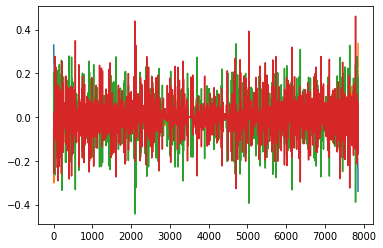

In [9]:
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
# figure(num=None, figsize=(8, 6), dpi=80, facecolor='w', edgecolor='k')

plt.plot(weights)
# locs, labels = plt.xticks() 
# print(locs, labels)
# plt.xticks([0, 1, 2, 3], targets)
plt.show()